Code to reproduce the figures from master thesis
Author: Sviatoslav Kharuk

# 3.2

In [1]:
# scseq env on cluster 
# import libraries
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scvelo as scv
import re
import seaborn as sns
import matplotlib
import scanpy.external as sce
import anndata as ad
import scipy

sc.settings.verbosity = 3 # verbosity: errors (0), warnings (1), info (2), hints (3)  ##! better to set 3
# verbosity is the amount of information that is printed to the screen. 
sc.logging.print_header() # print header info
sc.settings.set_figure_params(dpi=140, transparent=True, frameon=False) # set dpi and background color for figures

scv.logging.print_version() # show version  
scv.settings.presenter_view = True  # set max width size for presenter view
scv.set_figure_params('scvelo')

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

# try to get rid of the warnings
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning, module="scvelo.plotting.utils")

# import pertpy as pt

scanpy==1.9.6 anndata==0.10.8 umap==0.5.5 numpy==1.26.2 scipy==1.11.4 pandas==2.2.2 scikit-learn==1.1.3 statsmodels==0.14.1 igraph==0.11.6 pynndescent==0.5.11
Running scvelo 0.3.1 (python 3.10.14) on 2024-12-02 11:57.


ERROR: XMLRPC request failed [code: -32500]
RuntimeError: PyPI no longer supports 'pip search' (or XML-RPC search). Please use https://pypi.org/search (via a browser) instead. See https://warehouse.pypa.io/api-reference/xml-rpc.html#deprecated-methods for more information.


In [2]:
from statannotations.Annotator import Annotator


ModuleNotFoundError: No module named 'statannotations'

In [2]:
from functions import *

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [ ]:
adata = sc.read_h5ad("/g/huber/users/peidli/data/DECODE/version_1/SP_merged_filtered_feature_bc_matrix.h5ad")   

In [ ]:
### RELABELING, based on instructions from Siamak ###
adata.obs.perturbation = adata.obs.perturbation.astype(str)
adata.obs.perturbation = adata.obs.perturbation.replace({"fkh 00845": "GataE"})
adata = adata[~adata.obs.perturbation.isin(["Rab35.W", "Rab35.DN", "Rab35.CA", "FBNR control", "Arm.CA", "dcr, APCi", "Rab35i"])].copy()
adata = adata[~adata.obs.sample_name.isin(["TX32_1", "TX34_A"])].copy()
adata.obs["perturbation"][adata.obs.sample_name.isin(["TX29_1", "TX30_1", "TX31_1", "TX33_1"])] = "control"
adata.obs["perturbation"][adata.obs.sample_name.isin(["TX39_6"])] = "Crp"
adata.obs.perturbation.replace({
            "control (None)": "control",
            "control (esgts, cas9/+)": "control",
        }, inplace=True)
adata.obs.perturbation.replace({
            "Dome": "dome",
            "stat92E 00701": "Stat92E",
            "APC 1_2 gRNA": "APC1+2 gRNA",
            "Notch 1184 gRNA": "Notch gRNA",
            "USP 00341": "usp",
            "Rab11 (02478)": "Rab11",
            "rab11": "Rab11",
            "xbp1": "Xbp1",
        }, inplace=True)

In [4]:
# subset the data to 3' Notch + control
adata_notch_control_3p = adata[((adata.obs["perturbation"] == "control") &
                                ((adata.obs["sample_name"] == "TX22_A") |
                                (adata.obs["sample_name"] == "TX23_A"))) |
                                ((adata.obs["perturbation"] == "Notch gRNA") &
                                ((adata.obs["sample_name"] == "TX22_D") |
                                 (adata.obs["sample_name"] == "TX23_D")))].copy()

In [ ]:
# calcuate the QC metrics
# mito genes
adata_notch_control_3p.var["mt"] = adata_notch_control_3p.var_names.str.startswith("mt:") # # create new columns and store the information whether the gene is mitochondrial or not (True or False).
# calculate the metrics
sc.pp.calculate_qc_metrics(adata_notch_control_3p, qc_vars=["mt"], inplace = True, percent_top = None, log1p=False)

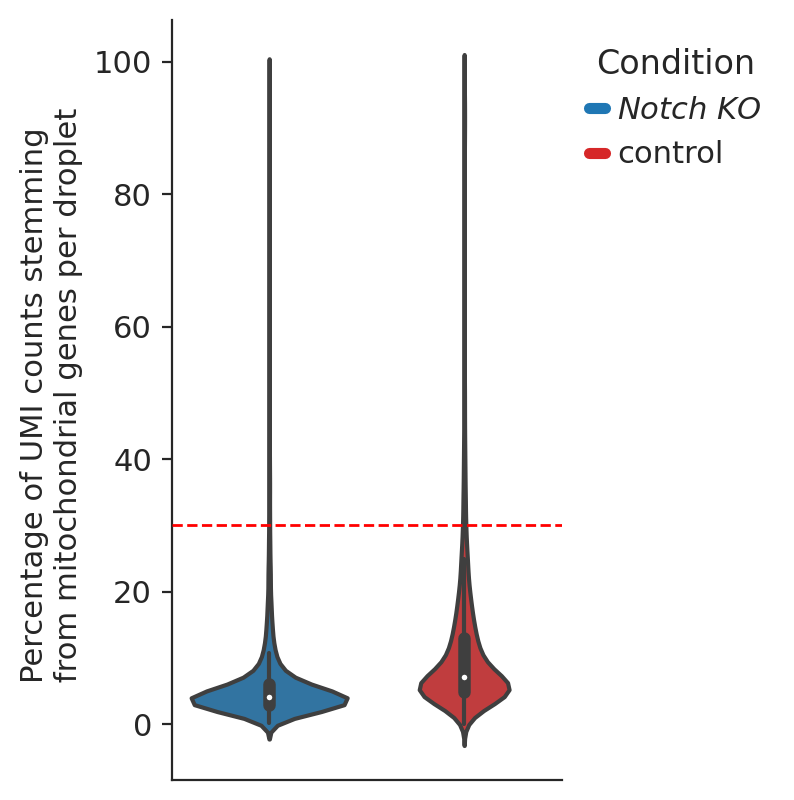

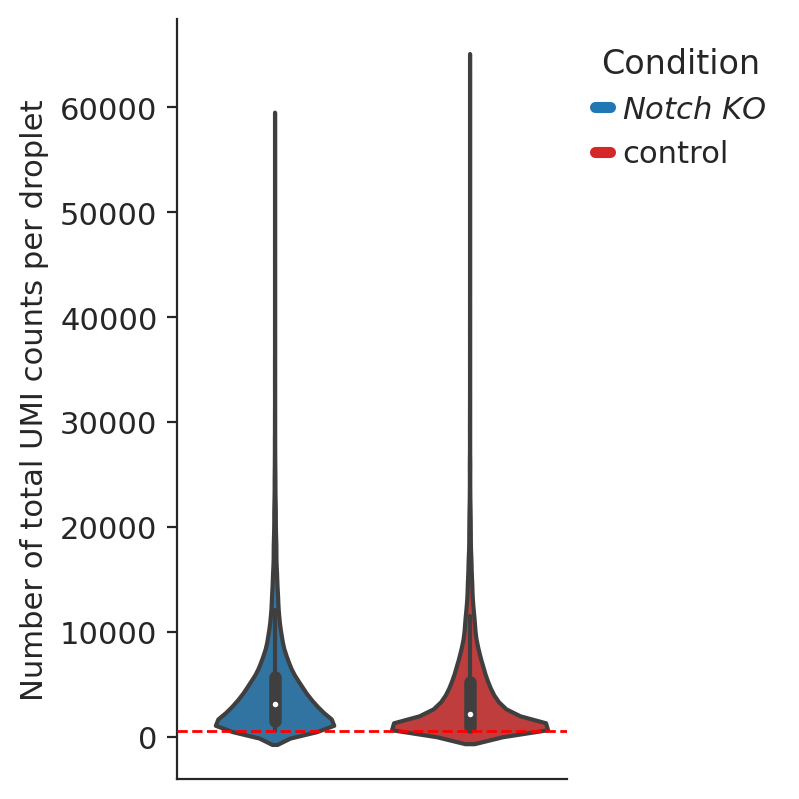

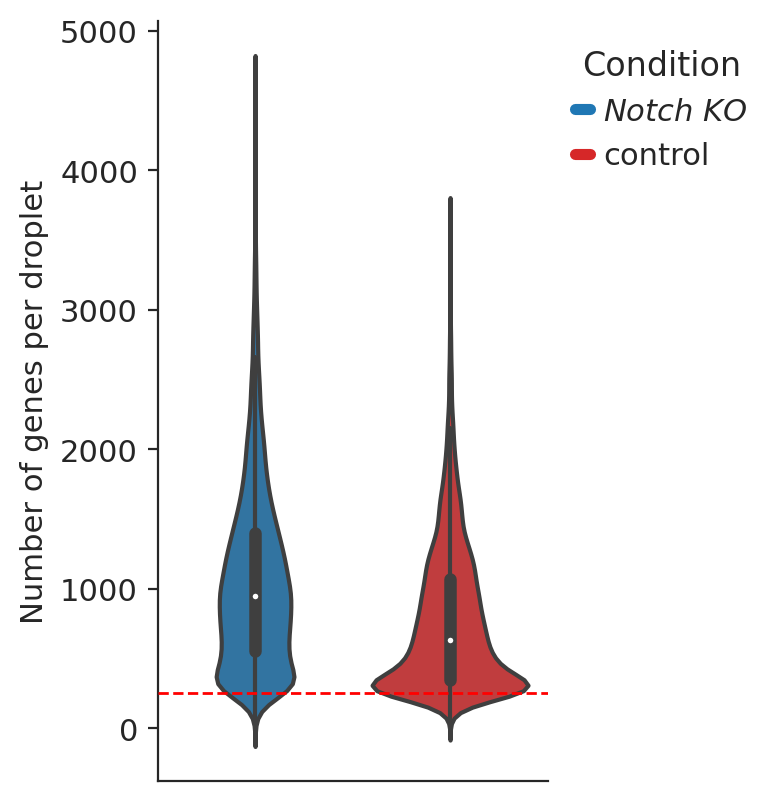

In [7]:
from matplotlib.lines import Line2D
palette={"Notch gRNA": "#1f77b4", "control": "#d62728"}

plt.figure(figsize=(2.5,5))
ax = sns.violinplot(data=adata_notch_control_3p.obs, y="pct_counts_mt", x="perturbation", palette=palette)
plt.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
plt.ylabel("Percentage of UMI counts stemming \n from mitochondrial genes per droplet")
ax.set(xlabel=None)
plt.axhline(y=30, color='red', linestyle='--', linewidth=1, zorder=10)
sns.despine()
legend_elements = [
    Line2D([0], [0], color=palette["Notch gRNA"], lw=4, label="$\it{Notch\ KO}$"),
    Line2D([0], [0], color=palette["control"], lw=4, label="control")]
plt.legend(handles=legend_elements, title="Condition", loc="upper left", bbox_to_anchor=(1, 1), frameon=False)
plt.show()

plt.figure(figsize=(2.5,5))
ax = sns.violinplot(data=adata_notch_control_3p.obs, y="total_counts", x="perturbation", palette=palette)
plt.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
plt.ylabel("Number of total UMI counts per droplet")
ax.set(xlabel=None)
plt.axhline(y=500, color='red', linestyle='--', linewidth=1, zorder=10)
sns.despine()
legend_elements = [
    Line2D([0], [0], color=palette["Notch gRNA"], lw=4, label="$\it{Notch\ KO}$"),
    Line2D([0], [0], color=palette["control"], lw=4, label="control")]
plt.legend(handles=legend_elements, title="Condition", loc="upper left", bbox_to_anchor=(1, 1), frameon=False)
plt.show()

plt.figure(figsize=(2.5,5))
ax = sns.violinplot(data=adata_notch_control_3p.obs, y="n_genes_by_counts", x="perturbation", palette=palette)
plt.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
plt.ylabel("Number of genes per droplet")
ax.set(xlabel=None)
plt.axhline(y=250, color='red', linestyle='--', linewidth=1, zorder=10)
sns.despine()
legend_elements = [
    Line2D([0], [0], color=palette["Notch gRNA"], lw=4, label="$\it{Notch\ KO}$"),
    Line2D([0], [0], color=palette["control"], lw=4, label="control")]
plt.legend(handles=legend_elements, title="Condition", loc="upper left", bbox_to_anchor=(1, 1), frameon=False)
plt.show()


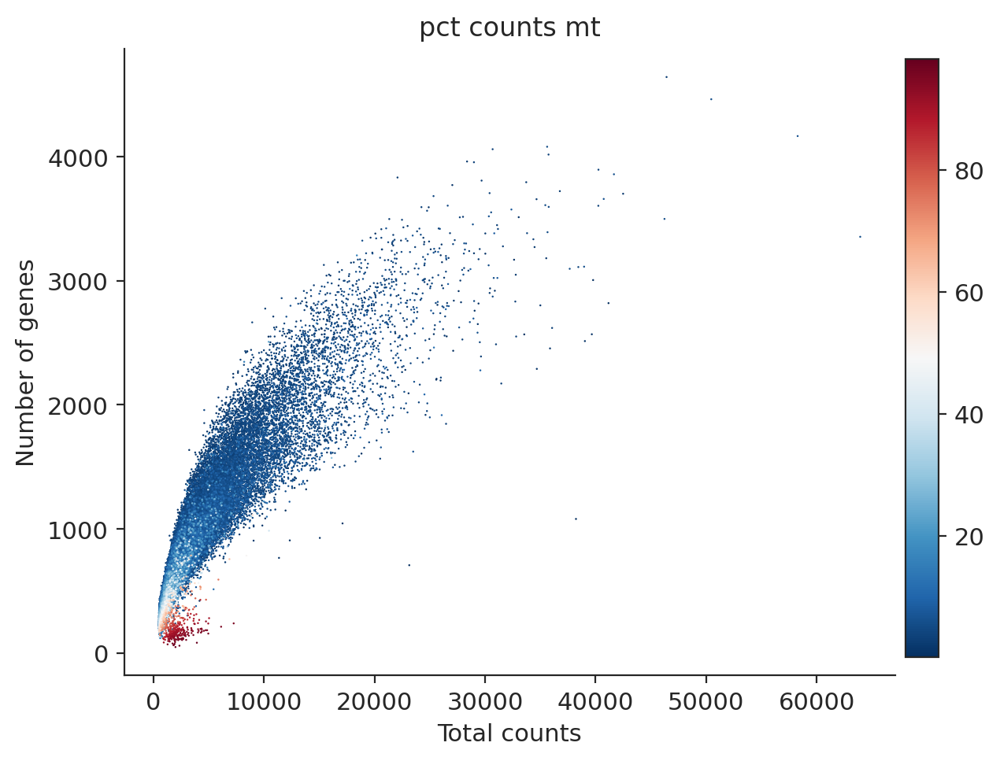

In [8]:
# Plot scatter plot for pct_counts_mt versus n_genes_by_counts
fig, ax = plt.subplots(figsize=(7, 5))  # Adjust figsize as needed
sc.pl.scatter(adata_notch_control_3p, x="total_counts", y="n_genes_by_counts", color="pct_counts_mt", ax=ax, show=False, frameon=False, color_map="RdBu_r")
# Add title and customize plot appearance
ax.set_xlabel("Total counts")
ax.set_ylabel("Number of genes")
ax.spines['right'].set_visible(False)  # Remove right spine
ax.spines['top'].set_visible(False)    # Remove top spine
fig.tight_layout(rect=[0, 0, 0.85, 1])  # Adjust the rectangle to move the legend
plt.show()

In [9]:
# filtering the cells
sc.pp.filter_cells(adata_notch_control_3p, min_counts=500)
sc.pp.filter_cells(adata_notch_control_3p, min_genes=250)
adata_notch_control_3p = adata_notch_control_3p[(adata_notch_control_3p.obs.pct_counts_mt>0.5)&(adata_notch_control_3p.obs.pct_counts_mt<30)].copy()


filtered out 1954 cells that have less than 250 genes expressed


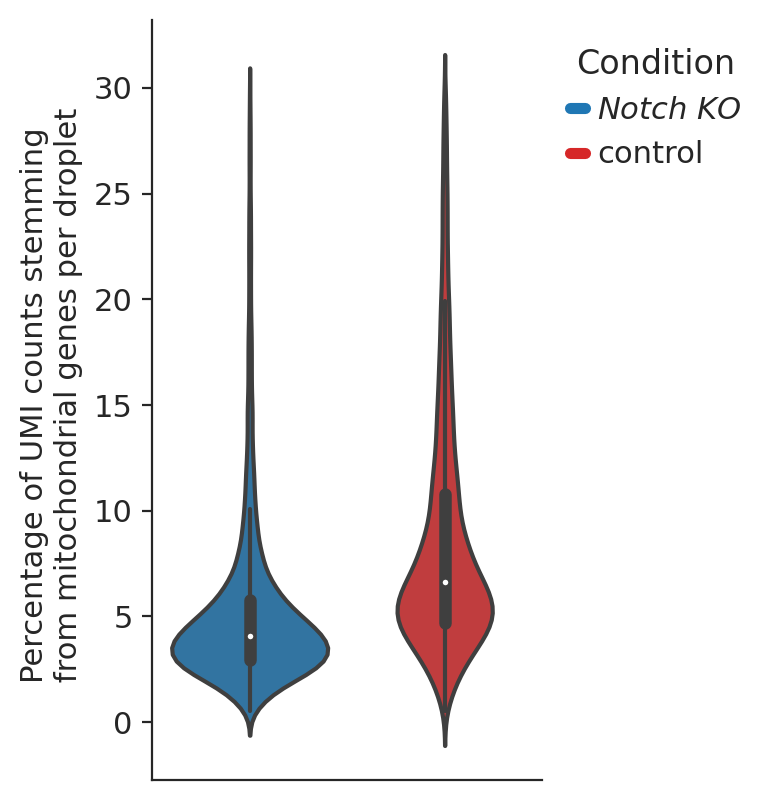

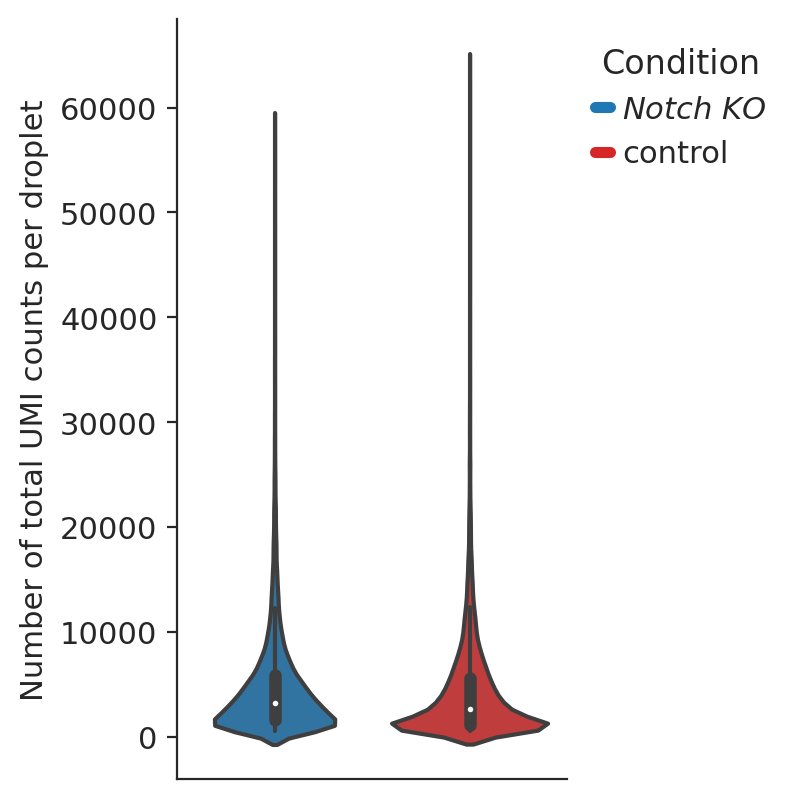

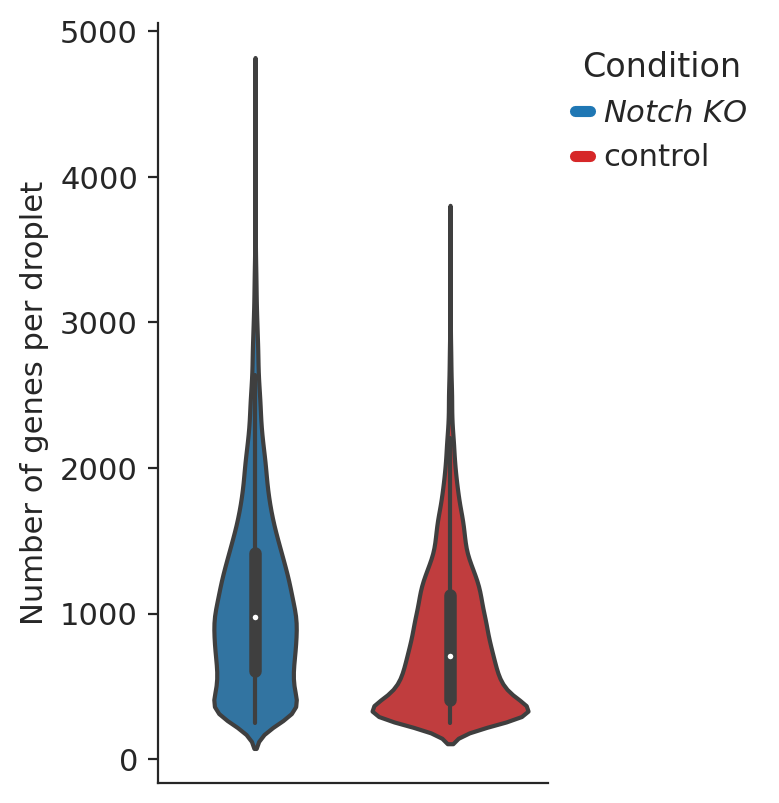

In [10]:
# plot QC after filtering

plt.figure(figsize=(2.5,5))
ax = sns.violinplot(data=adata_notch_control_3p.obs, y="pct_counts_mt", x="perturbation", palette=palette)
plt.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
plt.ylabel("Percentage of UMI counts stemming \n from mitochondrial genes per droplet")
ax.set(xlabel=None)
# plt.axhline(y=30, color='red', linestyle='--', linewidth=1, zorder=10)
sns.despine()
legend_elements = [
    Line2D([0], [0], color=palette["Notch gRNA"], lw=4, label="$\it{Notch\ KO}$"),
    Line2D([0], [0], color=palette["control"], lw=4, label="control")]
plt.legend(handles=legend_elements, title="Condition", loc="upper left", bbox_to_anchor=(1, 1), frameon=False)
plt.show()

plt.figure(figsize=(2.5,5))
ax = sns.violinplot(data=adata_notch_control_3p.obs, y="total_counts", x="perturbation", palette=palette)
plt.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
plt.ylabel("Number of total UMI counts per droplet")
ax.set(xlabel=None)
# plt.axhline(y=30, color='red', linestyle='--', linewidth=1, zorder=10)
sns.despine()
legend_elements = [
    Line2D([0], [0], color=palette["Notch gRNA"], lw=4, label="$\it{Notch\ KO}$"),
    Line2D([0], [0], color=palette["control"], lw=4, label="control")]
plt.legend(handles=legend_elements, title="Condition", loc="upper left", bbox_to_anchor=(1, 1), frameon=False)
plt.show()

plt.figure(figsize=(2.5,5))
ax = sns.violinplot(data=adata_notch_control_3p.obs, y="n_genes_by_counts", x="perturbation", palette=palette)
plt.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
plt.ylabel("Number of genes per droplet")
ax.set(xlabel=None)
# plt.axhline(y=30, color='red', linestyle='--', linewidth=1, zorder=10)
sns.despine()
legend_elements = [
    Line2D([0], [0], color=palette["Notch gRNA"], lw=4, label="$\it{Notch\ KO}$"),
    Line2D([0], [0], color=palette["control"], lw=4, label="control")]
plt.legend(handles=legend_elements, title="Condition", loc="upper left", bbox_to_anchor=(1, 1), frameon=False)
plt.show()


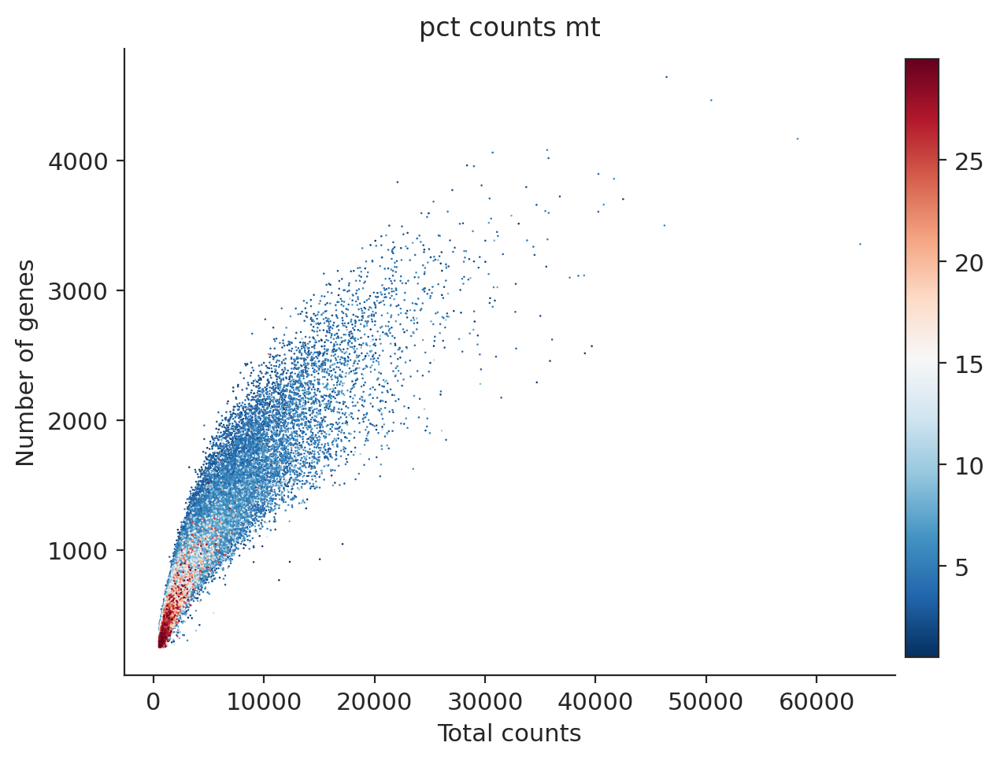

In [11]:
# Plot scatter plot for pct_counts_mt versus n_genes_by_counts

fig, ax = plt.subplots(figsize=(7, 5))  # Adjust figsize as needed
sc.pl.scatter(adata_notch_control_3p, x="total_counts", y="n_genes_by_counts", color="pct_counts_mt", ax=ax, show=False, frameon=False, color_map="RdBu_r")
# Add title and customize plot appearance
ax.set_xlabel("Total counts")
ax.set_ylabel("Number of genes")
ax.spines['right'].set_visible(False)  # Remove right spine
ax.spines['top'].set_visible(False)    # Remove top spine
fig.tight_layout(rect=[0, 0, 0.85, 1])  # Adjust the rectangle to move the legend
plt.show()

In [3]:
### plot total number of counts for spliced and unspliced layers
# env rvelo_milo
adata = sc.read_h5ad("../data/a_v_datas_merged_DECODE_v1_local_machine.h5ad")
# subset the data to the 3' Notch and 3' control samples together
adata_notch_control_3p = adata[((adata.obs["perturbation"] == "control") &
                                ((adata.obs["sample_name"] == "TX22_A") |
                                (adata.obs["sample_name"] == "TX23_A"))) |
                                ((adata.obs["perturbation"] == "Notch gRNA") &
                                ((adata.obs["sample_name"] == "TX22_D") |
                                 (adata.obs["sample_name"] == "TX23_D")))].copy()


In [ ]:
pd.DataFrame(adata_notch_control_3p.obsm["X_diffmap"], index=adata_notch_control_3p.obs_names).to_csv("/g/huber/users/kharuk/DECODE/adata_notch_control_3p_diffmap.csv")

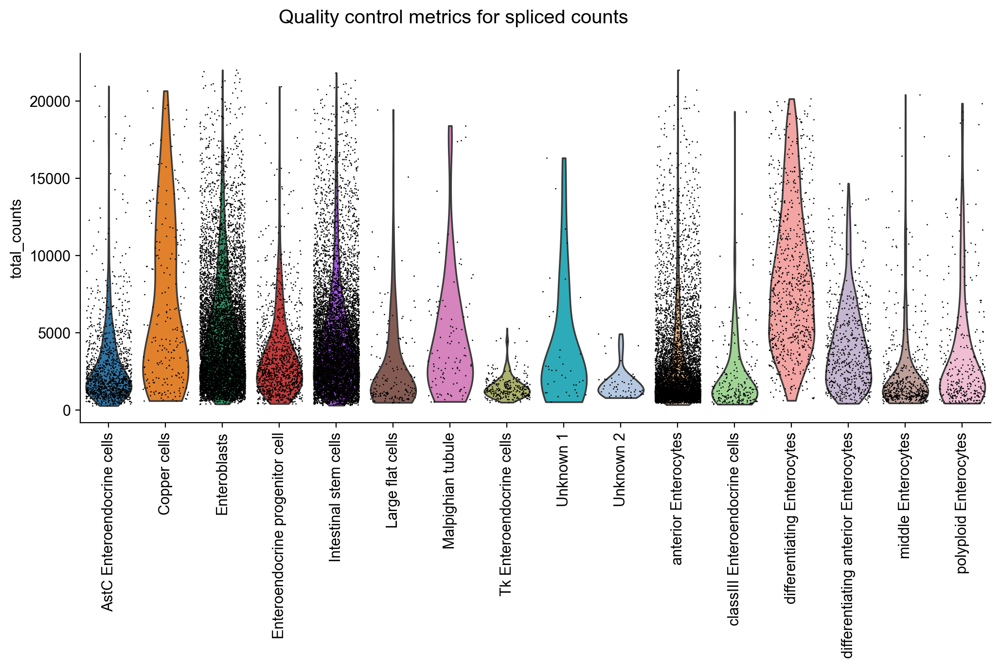

In [ ]:
adata_notch_control_3p = adata_notch_control_3p.copy()
adata_notch_control_3p.X = adata_notch_control_3p.layers["spliced"]
# calculate QC
adata_notch_control_3p.var["mt"] = adata_notch_control_3p.var_names.str.startswith("mt:")
sc.pp.calculate_qc_metrics(adata_notch_control_3p, qc_vars=["mt"], percent_top=None,
                            log1p=False, inplace=True)

fig, axs0 = plt.subplots(1, 1, figsize=(12, 5))  # Adjust figsize as needed
sc.pl.violin(adata_notch_control_3p, ["total_counts"], jitter=0.4, show=False, groupby = "high_res_annotation", rotation=90, ax=axs0) # do not have to specify the layer as it already calculated for specific layers
plt.suptitle(f"Quality control metrics for spliced counts", y=1)
axs0.spines['right'].set_visible(False)
axs0.spines['top'].set_visible(False)
plt.show()

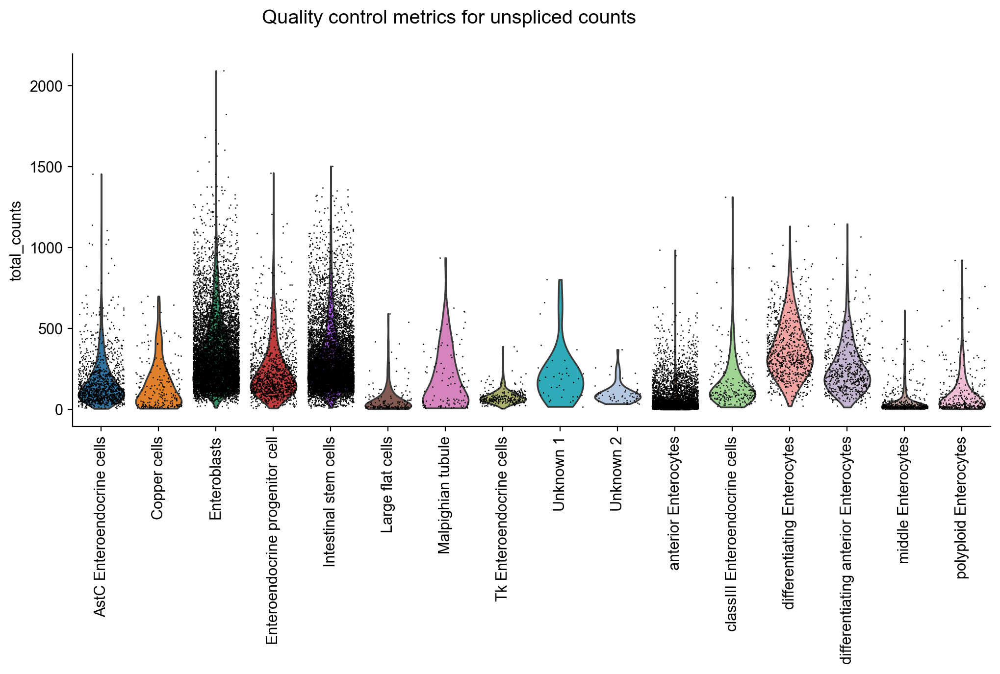

In [8]:
adata_notch_control_3p = adata_notch_control_3p.copy()
adata_notch_control_3p.X = adata_notch_control_3p.layers["unspliced"]
# calculate QC
adata_notch_control_3p.var["mt"] = adata_notch_control_3p.var_names.str.startswith("mt:")
sc.pp.calculate_qc_metrics(adata_notch_control_3p, qc_vars=["mt"], percent_top=None,
                            log1p=False, inplace=True)

fig, axs0 = plt.subplots(1, 1, figsize=(12, 5))  # Adjust figsize as needed
sc.pl.violin(adata_notch_control_3p, ["total_counts"], jitter=0.4, show=False, groupby = "high_res_annotation", rotation=90, ax=axs0) # do not have to specify the layer as it already calculated for specific layers
plt.suptitle(f"Quality control metrics for unspliced counts", y=1)
axs0.spines['right'].set_visible(False)
axs0.spines['top'].set_visible(False)
plt.show()

In [9]:
# calculate the spliced ratio
# calculate the counts for spliced and unspliced layers per cell by summing the counts in the cell for genes
adata_notch_control_3p.obs["ncounts_S"] = np.ravel(np.sum(adata_notch_control_3p.layers["spliced"], axis=1))
adata_notch_control_3p.obs["ncounts_U"] = np.ravel(np.sum(adata_notch_control_3p.layers["unspliced"], axis=1))

# remove cells with 0 counts in spliced or unspliced layers
adata_notch_control_3p = adata_notch_control_3p[adata_notch_control_3p.obs["ncounts_S"] > 0].copy()
adata_notch_control_3p = adata_notch_control_3p[adata_notch_control_3p.obs["ncounts_U"] > 0].copy()

# calculate the ratio of spliced counts per cell
adata_notch_control_3p.obs["spliced_ratio"] = adata_notch_control_3p.obs["ncounts_S"] / adata_notch_control_3p.obs["ncounts_U"]
adata_notch_control_3p.obs["spliced_ratio"]

cell_barcode
AGTACCATCCCGAAAT-TX22_D     28.712551
AATCGACGTACCCGCA-TX22_A     55.384615
ATCCTATGTTTCACTT-TX22_A    232.700000
CCGTGAGCAGGCCCTA-TX23_A      9.617347
CACGGGTTCGAGAACG-TX22_D     19.112676
                              ...    
GGTGAAGGTACTGCCG-TX22_D     15.305732
ACTTTGTGTATGACAA-TX22_D     16.090090
TTGACCCTCGGAGTGA-TX22_D     12.138728
CAAAGAATCCCTCTAG-TX22_A    198.666667
ATGCGATGTATCCTTT-TX22_D     13.487069
Name: spliced_ratio, Length: 35428, dtype: float64

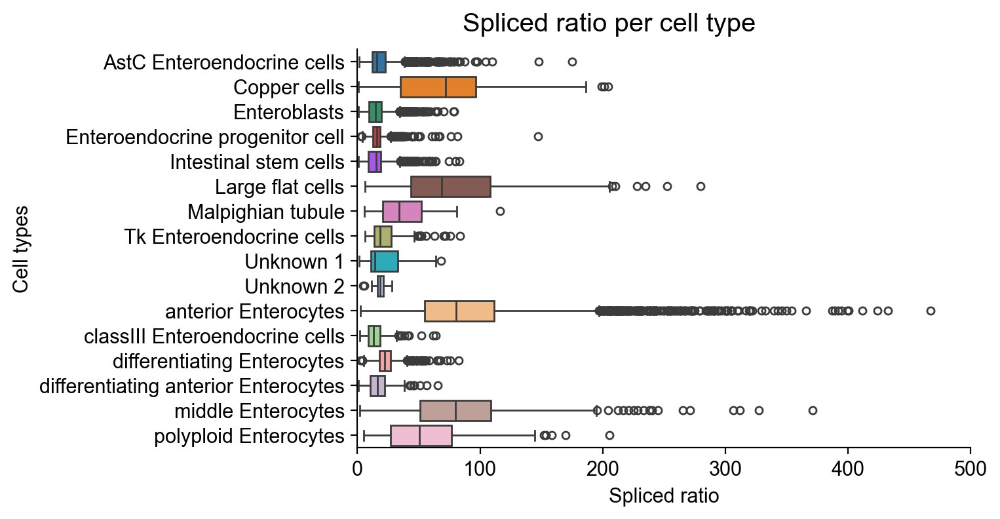

In [15]:
high_res_anotation_colors = adata_notch_control_3p.uns["high_res_annotation_colors"]

sns.boxplot(data = adata_notch_control_3p.obs, x="spliced_ratio", y="high_res_annotation", palette=high_res_anotation_colors, fliersize=4)
sns.despine()
plt.suptitle("Spliced ratio per cell type")
# make the x axis more
plt.xlim(0, 500)
plt.ylabel("Cell types")
plt.xlabel("Spliced ratio")
plt.show()

# 3.3 

UMAP and diffmap may look a bit differ from figures in thesis (mirrored or small differences in clustering)

In [4]:
# env rvelo_milo, local machine 
# upload data
adata_notch_control_3p = sc.read_h5ad("../data/a_v_data_merged_DECODE_v1_Notch_Control_diffmap.h5ad")

In [ ]:
# compute pca, knn, umap and diffmap
scv.pp.pca(adata_notch_control_3p)
sc.pp.neighbors(adata_notch_control_3p)
sc.tl.umap(adata_notch_control_3p)
sc.tl.diffmap(adata_notch_control_3p)

In [4]:
sc.settings.set_figure_params(dpi=300, transparent=True, frameon=False) # set dpi and background color for figures


In [5]:
# add batch column to obs
adata_notch_control_3p.obs["batch"] = adata_notch_control_3p.obs["sample_name"].str[:-2]

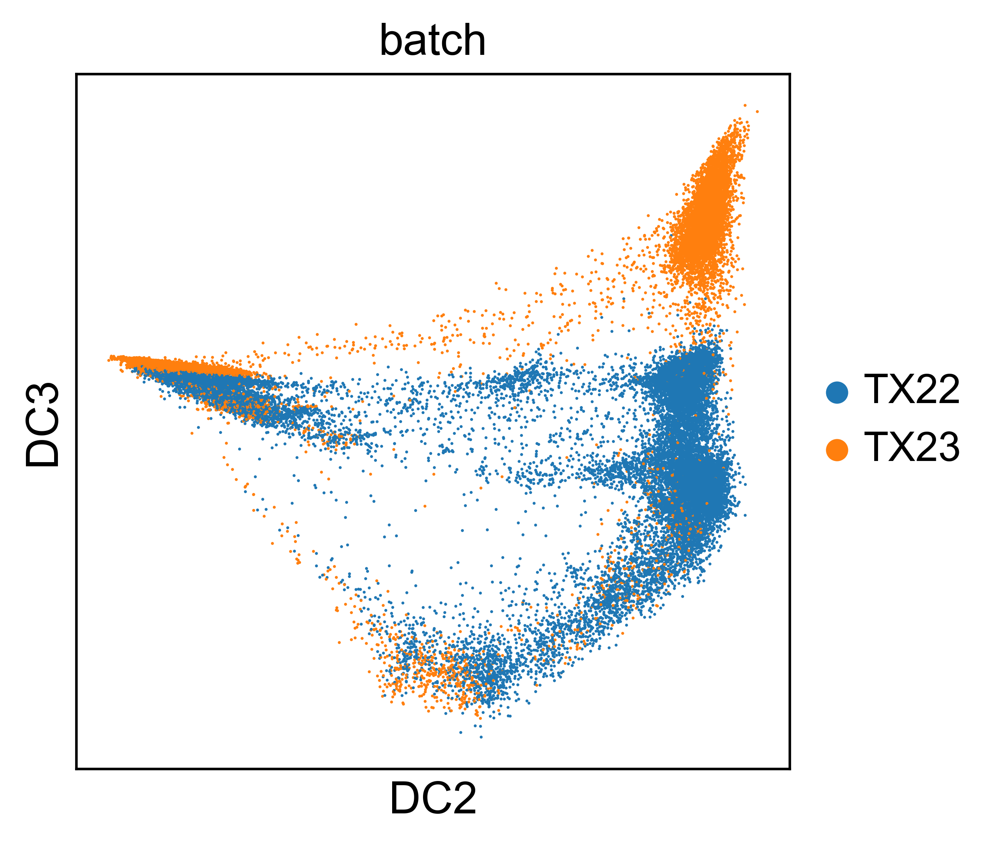

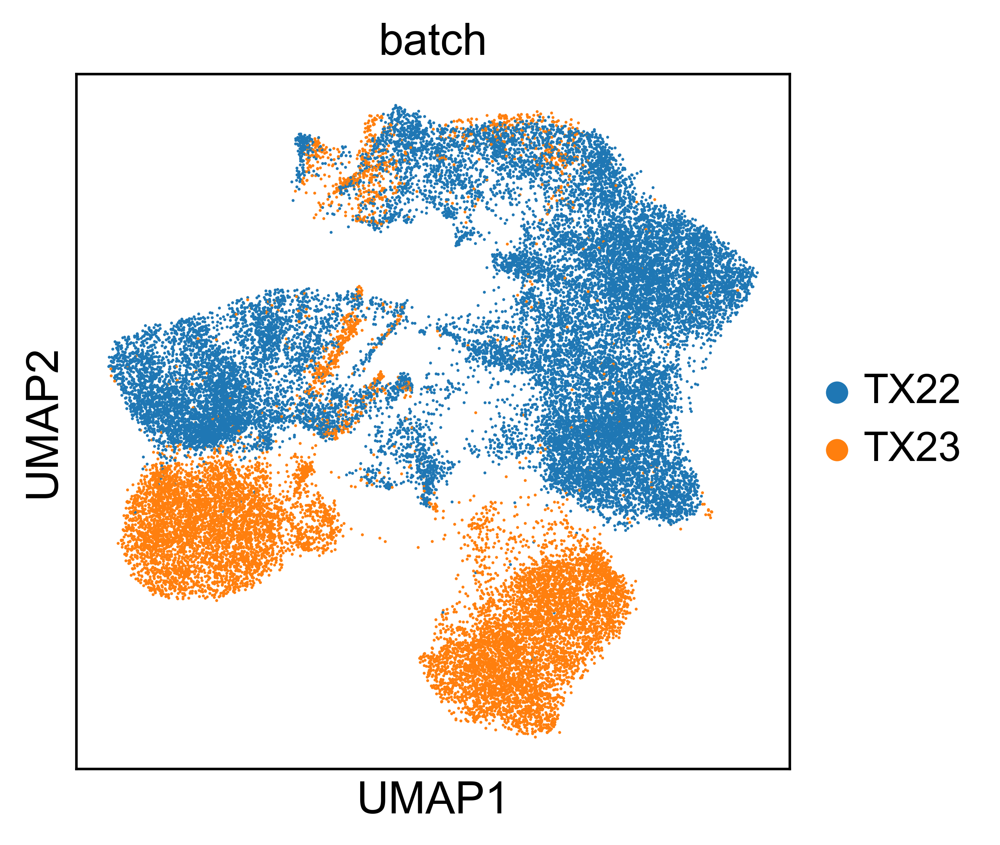

In [6]:
sc.pl.diffmap(adata_notch_control_3p, color="batch", components="2,3", frameon=True)
sc.pl.umap(adata_notch_control_3p, color="batch", frameon=True)

In [7]:
# run the Harmony correction for the nice diffmap
scv.pp.pca(adata_notch_control_3p) # n_comps 50 is default
sce.pp.harmony_integrate(adata_notch_control_3p, "batch", adjusted_basis="X_pca_harmony_batch",  max_iter_harmony = 50)
# compute the knn and UMAP for this harmony data
sc.pp.neighbors(adata_notch_control_3p, use_rep="X_pca_harmony_batch", key_added="neighbors_harmony_batch", n_neighbors=15)

# compute the diffmap
sc.tl.diffmap(adata_notch_control_3p, n_comps=15, neighbors_key="neighbors_harmony_batch") # n_comps 15 is default


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:04)


2024-11-30 12:56:36,045 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-11-30 12:56:41,385 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-11-30 12:56:41,457 - harmonypy - INFO - Iteration 1 of 50
2024-11-30 12:56:46,193 - harmonypy - INFO - Iteration 2 of 50
2024-11-30 12:56:50,882 - harmonypy - INFO - Iteration 3 of 50
2024-11-30 12:56:55,862 - harmonypy - INFO - Iteration 4 of 50
2024-11-30 12:57:01,006 - harmonypy - INFO - Iteration 5 of 50
2024-11-30 12:57:05,554 - harmonypy - INFO - Iteration 6 of 50
2024-11-30 12:57:10,745 - harmonypy - INFO - Iteration 7 of 50
2024-11-30 12:57:15,794 - harmonypy - INFO - Iteration 8 of 50
2024-11-30 12:57:19,403 - harmonypy - INFO - Iteration 9 of 50
2024-11-30 12:57:21,578 - harmonypy - INFO - Converged after 9 iterations


computing neighbors
    finished: added to `.uns['neighbors_harmony_batch']`
    `.obsp['neighbors_harmony_batch_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_harmony_batch_connectivities']`, weighted adjacency matrix (0:00:01)
computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.9972027  0.99087805 0.981328   0.980607   0.98039234
     0.9755672  0.9724665  0.969779   0.96264523 0.95945174 0.9583174
     0.9571273  0.95503926 0.9529672 ]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:00)


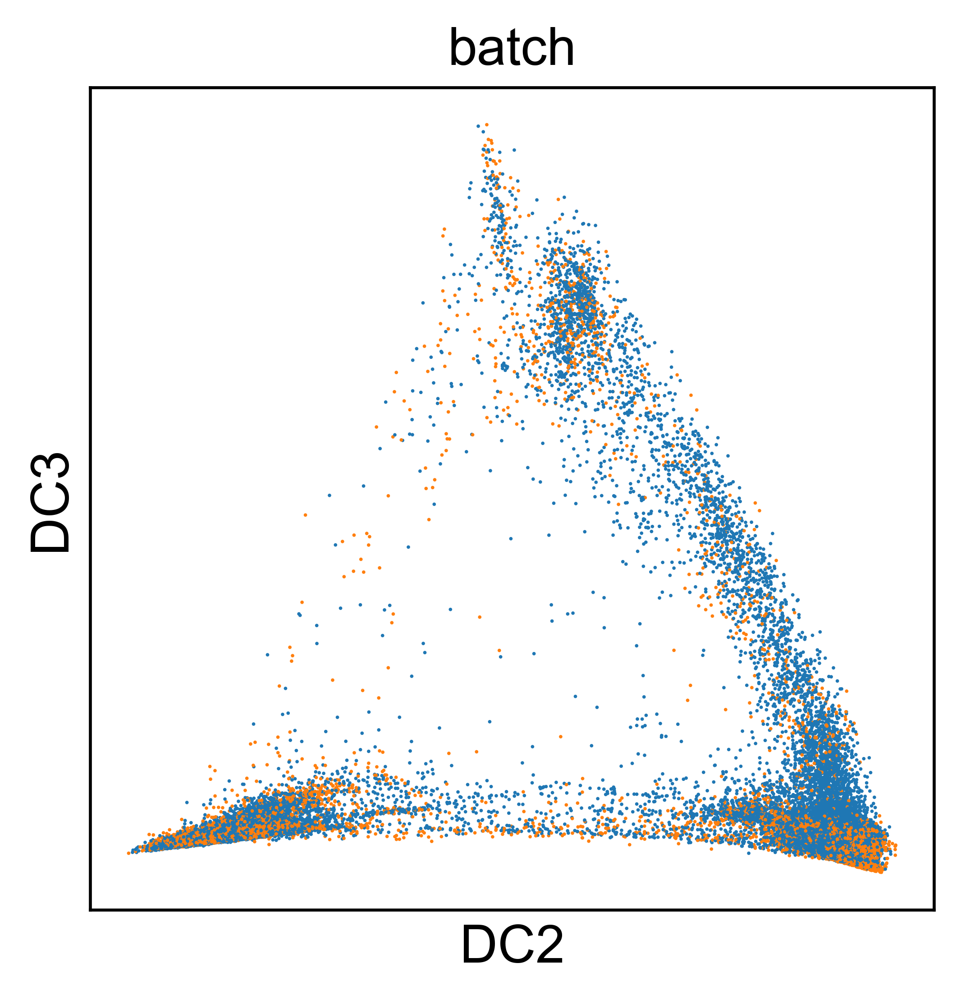

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:15)


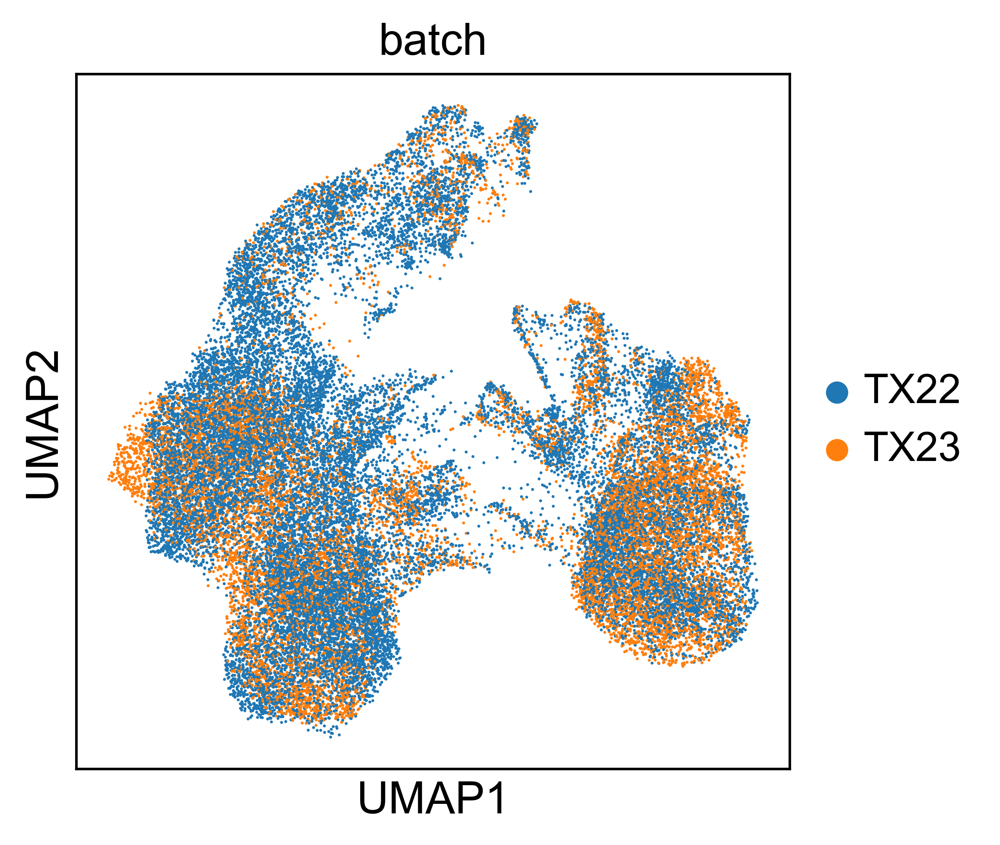

In [8]:
sc.pl.diffmap(adata_notch_control_3p, color=["batch"], components="2,3", frameon=True, legend_loc=None)
sc.tl.umap(adata_notch_control_3p, neighbors_key="neighbors_harmony_batch")
sc.pl.umap(adata_notch_control_3p, color=["batch"], legend_loc="right margin", frameon=True)

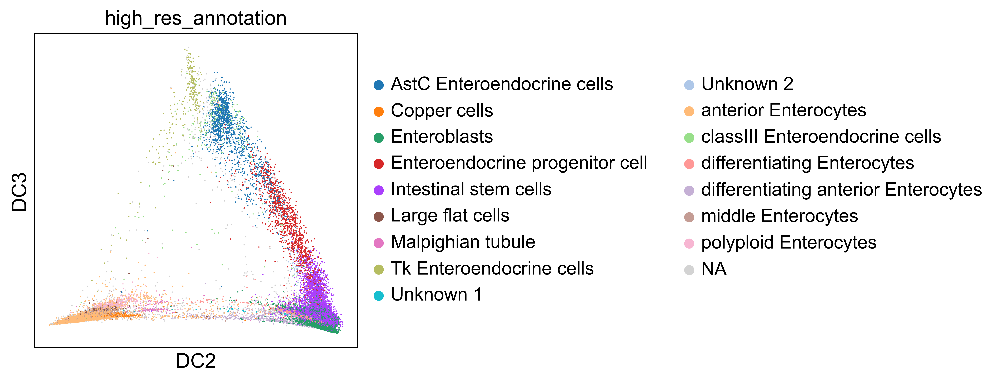

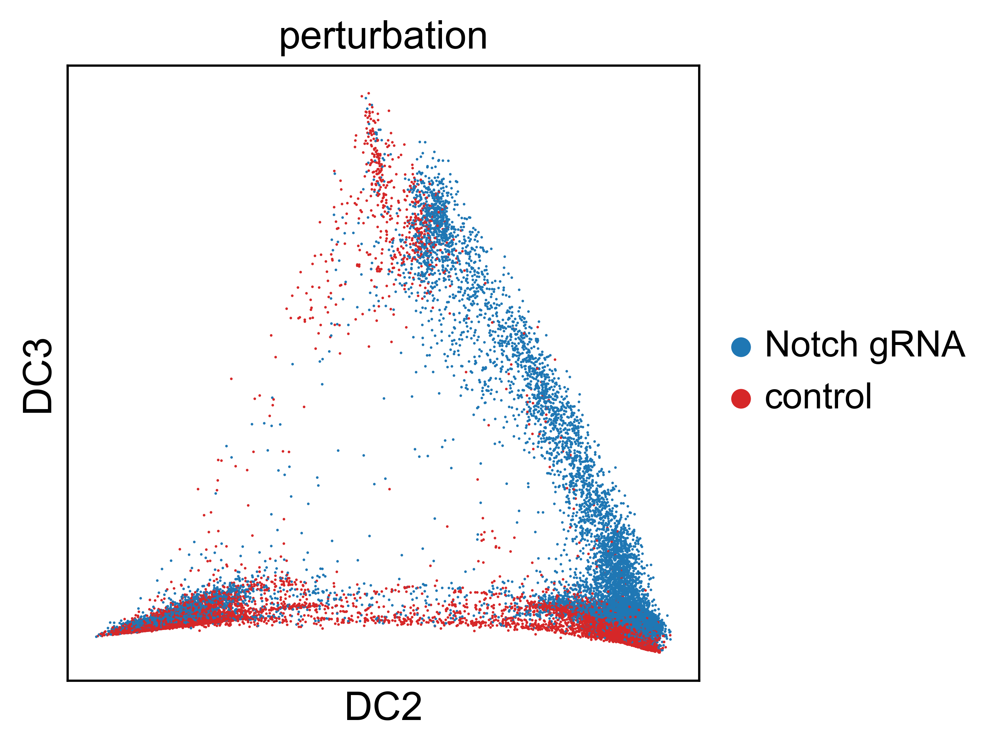

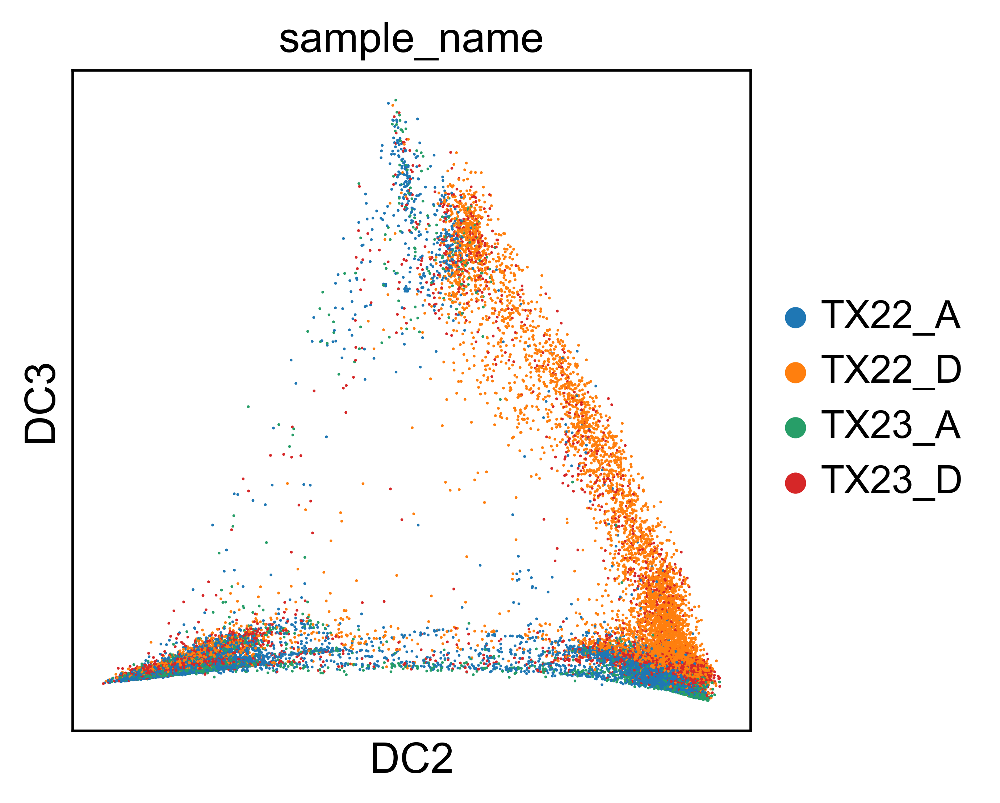

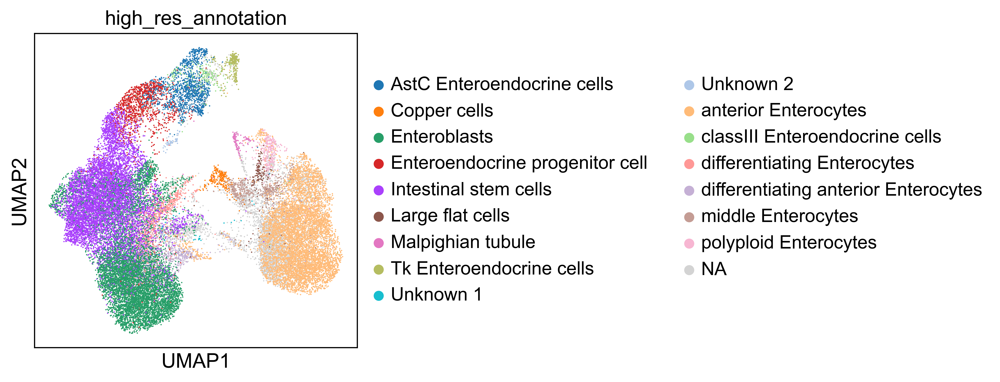

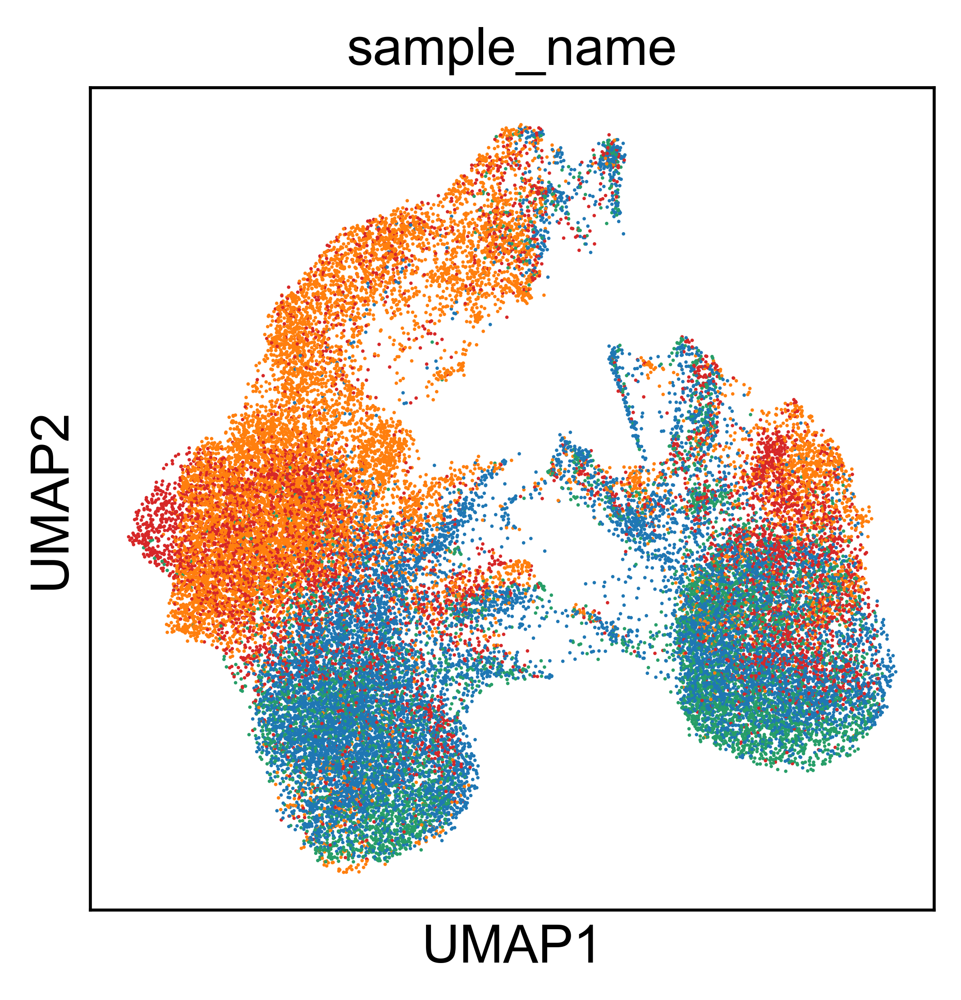

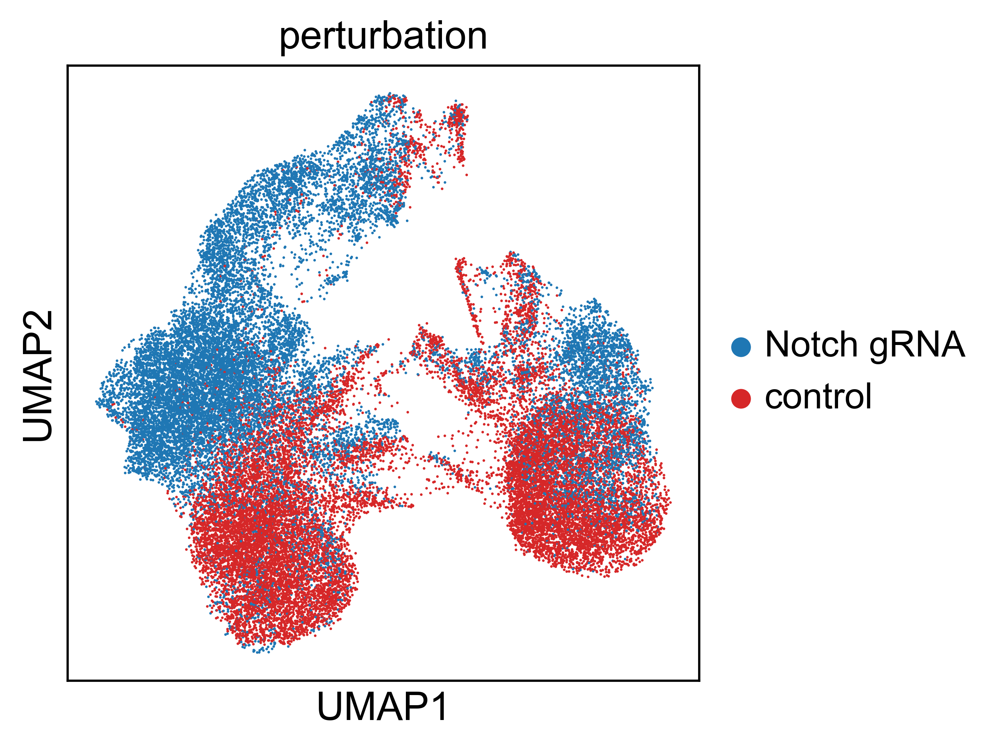

In [36]:
# assign colors for conditions
adata_notch_control_3p.uns["perturbation_colors"] = ["#1f77b4", "#d62728"]
# plot umap and diffmap
sc.pl.diffmap(adata_notch_control_3p, color=["high_res_annotation"], components="2,3", frameon=True)
sc.pl.diffmap(adata_notch_control_3p, color=["perturbation"], components="2,3", frameon=True)
sc.pl.diffmap(adata_notch_control_3p, color=["sample_name"], components="2,3", frameon=True)

sc.pl.umap(adata_notch_control_3p, color=["high_res_annotation"], legend_loc="right margin", frameon=True)
sc.pl.umap(adata_notch_control_3p, color=["sample_name"], legend_loc=None, frameon=True)
sc.pl.umap(adata_notch_control_3p, color=["perturbation"], legend_loc="right margin", frameon=True)



# 3.4

In [3]:
# env rvelo_milo
adata = sc.read_h5ad("../data/a_v_datas_merged_DECODE_v1_local_machine.h5ad")

In [4]:
# subset the data to the 3' Notch and 3' control samples together
adata_notch_control_3p = adata[((adata.obs["perturbation"] == "control") &
                                ((adata.obs["sample_name"] == "TX22_A") |
                                (adata.obs["sample_name"] == "TX23_A"))) |
                                ((adata.obs["perturbation"] == "Notch gRNA") &
                                ((adata.obs["sample_name"] == "TX22_D") |
                                 (adata.obs["sample_name"] == "TX23_D")))].copy()


In [5]:
adata_notch_control_3p.obs["batch"] = adata_notch_control_3p.obs["sample_name"].str[:-2]

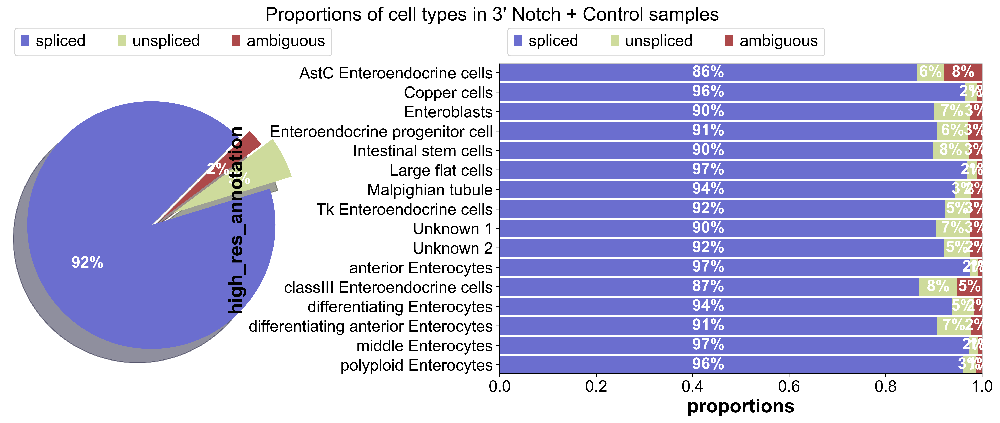

In [7]:
scv.pl.proportions(adata_notch_control_3p, groupby="high_res_annotation", figsize=(20, 6), show=False, dpi=200, fontsize=17)
plt.suptitle("Proportions of cell types in 3' Notch + Control samples", y=1.05, x=0.6, fontsize=20)
plt.show()

In [9]:
adata_control_notch_5p = adata[(adata.obs["perturbation"] == "control") |
                             (adata.obs["perturbation"] == "Notch gRNA")].copy()

### there are 4 3' samples in the data 22 and 23 - TX22_A, TX23_A, TX22_D, TX23_D, 
# I have to remove 3' Notch and control

# create a boolean for the samples
prime3_samples_control = (adata_control_notch_5p.obs["sample_name"] == "TX22_A") | (adata_control_notch_5p.obs["sample_name"] == "TX23_A")
# remove the samples if the bool == True
adata_control_notch_5p = adata_control_notch_5p[~prime3_samples_control]

prime3_samples_notch = (adata_control_notch_5p.obs["sample_name"] == "TX22_D") | (adata_control_notch_5p.obs["sample_name"] == "TX23_D")
adata_control_notch_5p = adata_control_notch_5p[~prime3_samples_notch]


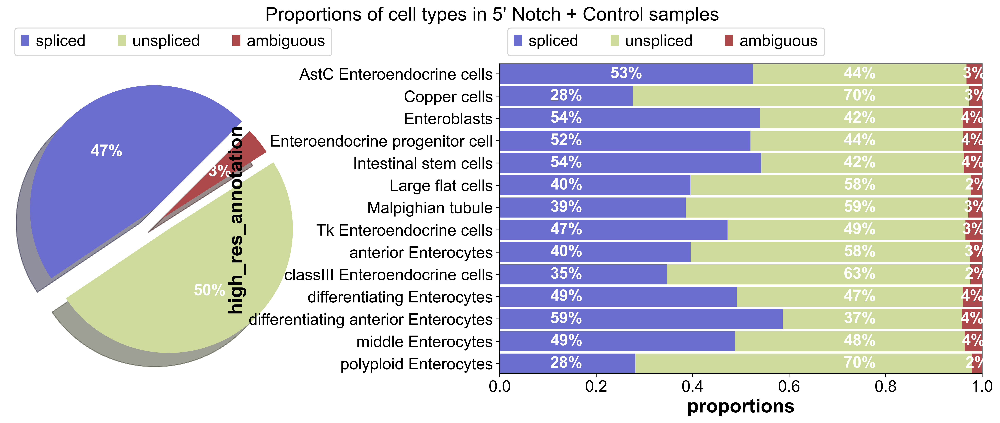

In [19]:
scv.pl.proportions(adata_control_notch_5p, groupby="high_res_annotation", figsize=(20, 6), show=False, dpi=200, fontsize=17)
plt.suptitle("Proportions of cell types in 5' Notch + Control samples", y=1.05, x=0.6, fontsize=20)
plt.show()

In [ ]:
# RNA velocity phase portraits for 3' Notch + control
adata_notch_control_3p, top_ranked_genes_notch_contol_3p = velocity_inferring_wo_plot(adata_notch_control_3p, 
                                                                     min_shared_counts=20, n_top_genes=500, mode = "stochastic", 
                                                                     annotation = "high_res_annotation")


 Applying min_shared_counts filter 

Filtered out 8918 genes that are detected 20 counts (shared).
Normalized count data: spliced, unspliced.
If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
'
 Computing PCA, knn and UMAP 
 
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:15)

 Computing RNA velocity 
 
computing neighbors
    finished (0:00:03) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.o

/opt/homebrew/Caskroom/miniconda/base/envs/rvelo_milo/lib/python3.10/site-packages/scvelo/tools/optimization.py:184: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  gamma[i] = np.linalg.pinv(A.T.dot(A)).dot(A.T.dot(y[:, i]))


    finished (0:00:07) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/8 cores)


python(55559) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


    finished (0:00:48) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
ranking velocity genes


/opt/homebrew/Caskroom/miniconda/base/envs/rvelo_milo/lib/python3.10/site-packages/scvelo/tools/utils.py:463: DeprecationWarning: Please use `rankdata` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  from scipy.stats.stats import rankdata


    finished (0:00:23) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


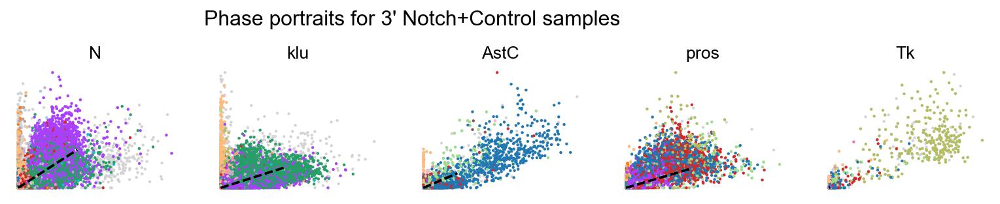

In [20]:
kwargs = dict(frameon=False, size=15, linewidth=1.5)

# plot the some marker genes for 3' samples
scv.pl.scatter(adata_notch_control_3p, ["N", "klu", "AstC", "pros", "Tk"], **kwargs, color="high_res_annotation", show=False)
plt.suptitle("Phase portraits for 3' Notch+Control samples", y=1.25)
plt.show()

In [21]:
# RNA velocity phase portraits for 5' Notch + control
adata_notch_control_5p, top_ranked_genes_notch_contol_5p = velocity_inferring_wo_plot(adata_control_notch_5p, 
                                                                     min_shared_counts=20, n_top_genes=500, mode = "stochastic", 
                                                                     annotation = "high_res_annotation")



 Applying min_shared_counts filter 

Filtered out 10822 genes that are detected 20 counts (shared).
Normalized count data: spliced, unspliced.
If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
'
 Computing PCA, knn and UMAP 
 
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:02)
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:18)

 Computing RNA velocity 
 
computing neighbors
    finished (0:00:03) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.

/opt/homebrew/Caskroom/miniconda/base/envs/rvelo_milo/lib/python3.10/site-packages/scvelo/tools/optimization.py:184: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  gamma[i] = np.linalg.pinv(A.T.dot(A)).dot(A.T.dot(y[:, i]))


    finished (0:00:02) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/8 cores)


python(55586) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


    finished (0:00:17) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
ranking velocity genes


/opt/homebrew/Caskroom/miniconda/base/envs/rvelo_milo/lib/python3.10/site-packages/scvelo/tools/utils.py:463: DeprecationWarning: Please use `rankdata` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  from scipy.stats.stats import rankdata


    finished (0:00:09) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


In [23]:
adata_notch_control_5p.uns["high_res_annotation_colors"] = ['#1f77b4', '#ff7f0e', '#279e68', 
                                                               '#d62728', '#aa40fc', '#8c564b', '#e377c2',
                                                               '#b5bd61', '#ffbb78', '#98df8a',
                                                                '#ff9896', '#c5b0d5', '#c49c94', '#f7b6d2']
# rename the the cell types to the short names
adata_notch_control_5p.obs["high_res_annotation"] = adata_notch_control_5p.obs["high_res_annotation"].replace({"Enteroblasts": "EB",
                                                                                                               "Large flat cells": "LFC",
                                                                                                                "middle Enterocytes": "mEC",
                                                                                                                "anterior Enterocytes": "aEC",
                                                                                                                "Intestinal stem cells": "ISC",
                                                                                                                "differentiating Enterocytes": "dEC",
                                                                                                                "Copper cells": "Copper",
                                                                                                                "polyploid Enterocytes": "pEC",
                                                                                                                "Malpighian tubule": "MT",
                                                                                                                "differentiating anterior Enterocytes": "daEC",
                                                                                                                "AstC Enteroendocrine cells": "AstC EEc",
                                                                                                                "Enteroendocrine progenitor cell": "EEpc",
                                                                                                                "Tk Enteroendocrine cells": "Tk EEc",
                                                                                                                "classIII Enteroendocrine cells": "classIII EEc"})


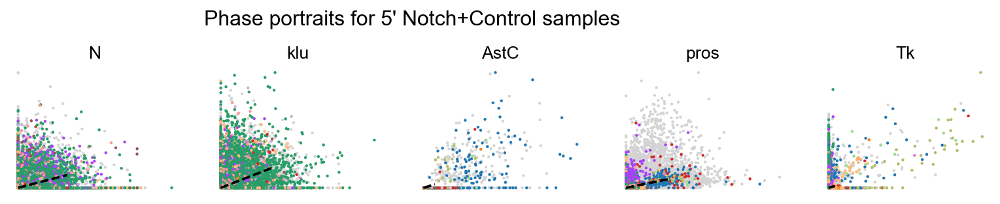

In [24]:
# plot PPs for 5' samples
scv.pl.scatter(adata_notch_control_5p, ["N", "klu", "AstC", "pros", "Tk"], **kwargs, color="high_res_annotation", show=False)
plt.suptitle("Phase portraits for 5' Notch+Control samples", y=1.25)
plt.show()


In [5]:
def corr_adata(adata, genes=None, method='spearman'):
    """Linearly correlates features (genes/obs_keys) of adata with a given array.
    Computes pearson linear correlation (r and p value) for each selected feature
    with the given values in x.
    ----------
    adata: An adata object.
    genes: list, optional
    List of genes to analyze. If None, uses all genes
    method: str
    method: Either 'spearman' or 'pearson'.
    Returns
    -------
    df: A pandas DataFrame
        The dataframe has genes as index and columns pearson_r and pearson_p. It
        is sorted by correlation coefficient (pearson_r).
    """
    from scipy.stats import spearmanr, pearsonr
    from scipy.sparse import issparse
    import pandas as pd
    import numpy as np
    from tqdm import tqdm

    # select genes
    genes = genes if genes is not None else adata.var_names.tolist()

    # select correlation method
    if method == 'spearman':
        correlate = spearmanr
    elif method == 'pearson':
        correlate = pearsonr
    else:
        raise ValueError(f'Method {method} not valid (pearson or spearman only).')
    
    # get spliced and unspliced lahers
    spliced = adata.layers['spliced']
    unspliced = adata.layers['unspliced']

    # feature set
    if issparse (spliced):
        spliced = spliced.A
    if issparse (unspliced):
        unspliced = unspliced.A
        
    lincors = []
    for genes_id, gene in enumerate(tqdm(genes)):
        s = spliced[:, genes_id]
        u = unspliced[:, genes_id]
        r, p = correlate(s, u)
        lincors.append([gene, r, p])
    # format result as pandas.DataFrame
    df = pd.DataFrame(lincors, columns=["gene", f'{method}_r', f'{method}_p'])
    df = df.set_index("gene")
    df = df.sort_values(f'{method}_r', ascending=False)  # sort by correlation
    return df

In [6]:
scv.pp.filter_genes(adata_notch_control_3p, min_shared_counts=20)
scv.pp.filter_genes_dispersion(adata_notch_control_3p, n_top_genes=1000)


Filtered out 8918 genes that are detected 20 counts (shared).


/opt/homebrew/Caskroom/miniconda/base/envs/rvelo/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/opt/homebrew/Caskroom/miniconda/base/envs/rvelo/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
/opt/homebrew/Caskroom/miniconda/base/envs/rvelo/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See http

Extracted 1000 highly variable genes.


In [ ]:
"""Correlation coef for 3' unspliced and spliced counts layers"""
df_corr_3p_spearman = corr_adata(adata_notch_control_3p, method="spearman")

In [12]:
# correlation for 5' samples
scv.pp.filter_genes(adata_control_notch_5p, min_shared_counts=20)
scv.pp.filter_genes_dispersion(adata_control_notch_5p, n_top_genes=1000)

Filtered out 10822 genes that are detected 20 counts (shared).


/opt/homebrew/Caskroom/miniconda/base/envs/rvelo/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/opt/homebrew/Caskroom/miniconda/base/envs/rvelo/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
/opt/homebrew/Caskroom/miniconda/base/envs/rvelo/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See http

Extracted 1000 highly variable genes.


In [ ]:
df_corr_5p_spearman = corr_adata(adata_control_notch_5p, method="spearman")

#### Compare correlation for 3' and 5' samples

In [ ]:
### Spearman correlation
df_corr_3p_spearman.rename(columns={"spearman_r": "spearman_r_3p_u_s"}, inplace=True)
df_corr_5p_spearman.rename(columns={"spearman_r": "spearman_r_5p_u_s"}, inplace=True)
# change the gene index names to numbers
df_corr_3p_spearman.index = range(1, 1001)
df_corr_5p_spearman.index = range(1, 1001)
# concatenate the dataframes in one for plotting
df_corr_3p_5p_spearman = pd.concat([df_corr_3p_spearman, df_corr_5p_spearman], axis=1)


In [ ]:
"""Filter outliers for Spearman correlation"""
# filter outliers from the dataframe as in the boxplot
Q1 = df_corr_3p_5p_spearman['spearman_r_3p_u_s'].quantile(0.25)
Q3 = df_corr_3p_5p_spearman['spearman_r_3p_u_s'].quantile(0.75)
IQR = Q3 - Q1    #IQR is interquartile range. 

filter = (df_corr_3p_5p_spearman['spearman_r_3p_u_s'] >= Q1 - 1.5 * IQR) & (df_corr_3p_5p_spearman['spearman_r_3p_u_s'] <= Q3 + 1.5 *IQR)
df_corr_3p_5p_spearman['spearman_r_3p_u_s'].loc[filter]  

# make filtered pandas df
df_corr_3p_5p_spearman_filtered = df_corr_3p_5p_spearman.loc[filter]

# filter outliers from the dataframe as in the boxplot
Q1 = df_corr_3p_5p_spearman['spearman_r_5p_u_s'].quantile(0.25)
Q3 = df_corr_3p_5p_spearman['spearman_r_5p_u_s'].quantile(0.75)
IQR = Q3 - Q1    #IQR is interquartile range. 

filter = (df_corr_3p_5p_spearman['spearman_r_5p_u_s'] >= Q1 - 1.5 * IQR) & (df_corr_3p_5p_spearman['spearman_r_5p_u_s'] <= Q3 + 1.5 *IQR)
df_corr_3p_5p_spearman['spearman_r_5p_u_s'].loc[filter]

# make filtered pandas df
df_corr_3p_5p_spearman_filtered_1 = df_corr_3p_5p_spearman.loc[filter]


In [17]:
# make one with two columns from the filtered dataframes for Speamrman correlation
# from df_corr_3p_5p_spearman_filtered take only the spearman_r_3p_u_s column
# from df_corr_3p_5p_spearman_filtered_1 take only the spearman_r_5p_u_s column
df_corr_3p_5p_spearman_filtered_2 = pd.concat([df_corr_3p_5p_spearman_filtered["spearman_r_3p_u_s"],
                                                  df_corr_3p_5p_spearman_filtered_1["spearman_r_5p_u_s"]], axis=1)

p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

spearman_r_3p_u_s vs. spearman_r_5p_u_s: Welch's t-test independent samples, P_val:1.209e-94 t=2.262e+01


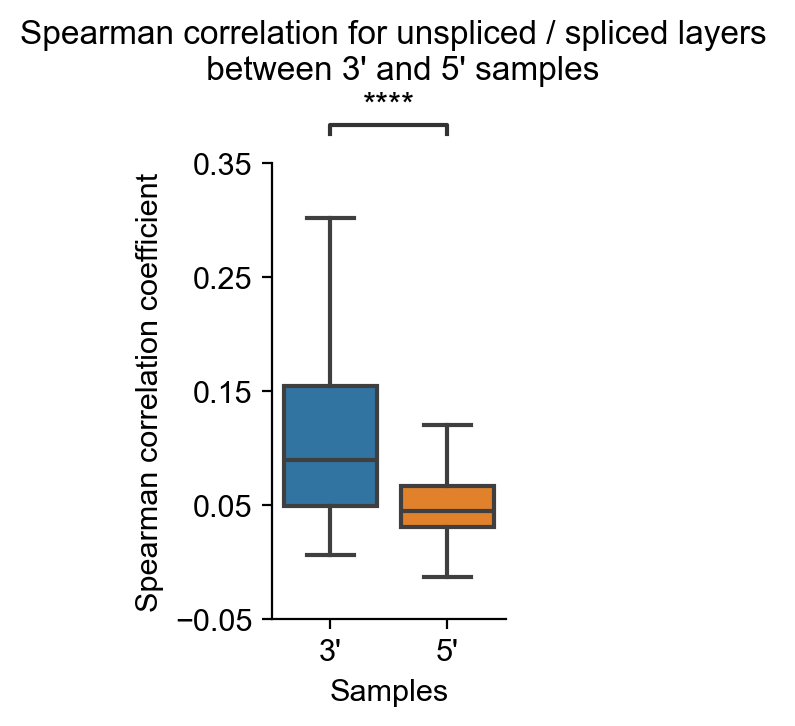

In [19]:
# plot the filtered data with t-test Welch's
# ! after filtering a few outliers still remain
ax = plt.figure(figsize=(1.5, 3))
ax = sns.boxplot(data=df_corr_3p_5p_spearman_filtered_2[["spearman_r_3p_u_s", "spearman_r_5p_u_s"]], width=0.8,fliersize=0, dodge=False) # fliersize - remove the outliers from the boxplot
annot = Annotator(ax, [("spearman_r_3p_u_s", "spearman_r_5p_u_s")], data=df_corr_3p_5p_spearman_filtered_2[["spearman_r_3p_u_s", "spearman_r_5p_u_s"]])  
annot.configure(test='t-test_welch', text_format='star', loc='inside', verbose=2)
annot.apply_test()
ax, test_results = annot.annotate()
sns.despine()
plt.ylim(-0.05, 0.35)
plt.yticks(np.arange(-0.05, 0.40, 0.1))
plt.ylabel("Spearman correlation coefficient")
plt.xticks([0, 1], ['3\'', '5\''])
plt.xlabel("Samples")
plt.suptitle("Spearman correlation for unspliced / spliced layers \n between 3' and 5' samples", fontsize="medium", y=1.15, x=0.6)
plt.show()

# 3.6

In [6]:
# env rvelo milo
# subset the data to the 3' 22 Samples
adata_3p_22 = adata[((adata.obs["sample_name"] == "TX22_A") |
                    (adata.obs["sample_name"] == "TX22_D"))].copy()

In [8]:
adata_notch_control_3p_22, top_ranked_genes_n_c_3p_22 = velocity_inferring_wo_plot(adata_3p_22, min_shared_counts=20, n_top_genes=500, mode = "stochastic", annotation = "high_res_annotation")


 Applying min_shared_counts filter 

Filtered out 9139 genes that are detected 20 counts (shared).
Normalized count data: spliced, unspliced.
If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
'
 Computing PCA, knn and UMAP 
 
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:09)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:10)

 Computing RNA velocity 
 
computing neighbors
    finished (0:00:02) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.o

/opt/homebrew/Caskroom/miniconda/base/envs/rvelo_milo/lib/python3.10/site-packages/scvelo/tools/optimization.py:184: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  gamma[i] = np.linalg.pinv(A.T.dot(A)).dot(A.T.dot(y[:, i]))


    finished (0:00:03) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/8 cores)
or disable the progress bar using `show_progress_bar=False`.
    finished (0:00:28) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
ranking velocity genes


/opt/homebrew/Caskroom/miniconda/base/envs/rvelo_milo/lib/python3.10/site-packages/scvelo/tools/utils.py:463: DeprecationWarning: Please use `rankdata` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  from scipy.stats.stats import rankdata


    finished (0:00:12) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


In [22]:
adata_notch_control_3p_22.uns["high_res_annotation_colors"] 

['#023fa5',
 '#7d87b9',
 '#bec1d4',
 '#d6bcc0',
 '#bb7784',
 '#8e063b',
 '#4a6fe3',
 '#8595e1',
 '#b5bbe3',
 '#e6afb9',
 '#e07b91',
 '#d33f6a',
 '#11c638',
 '#8dd593',
 '#c6dec7',
 '#ead3c6']

In [24]:
adata_notch_control_3p_22.uns["high_res_annotation_colors"] = ['#1f77b4', 
                                                               '#ff7f0e', 
                                                               '#279e68', 
                                                               '#d62728', 
                                                               '#aa40fc', 
                                                               '#8c564b', 
                                                               '#e377c2',
                                                               '#b5bd61', 
                                                               '#17becf', 
                                                               '#ffbb78', 
                                                               '#98df8a',
                                                                '#ff9896', 
                                                                '#c5b0d5', 
                                                                '#c49c94', 
                                                                '#f7b6d2'] 

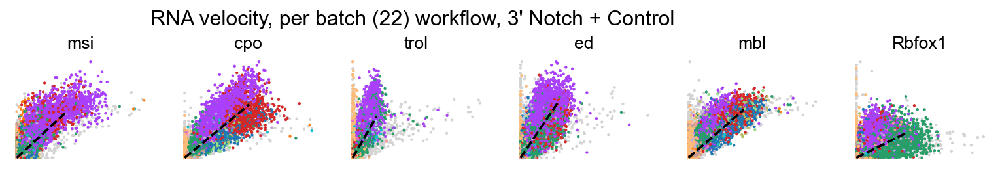

In [ ]:
scv.pl.scatter(adata_notch_control_3p_22, ["msi", "cpo", "trol", 'ed', "mbl", "Rbfox1"], color='high_res_annotation', frameon=False, size=15, linewidth=1.5, show=False)
plt.suptitle("RNA velocity, per batch (22) workflow, 3' Notch + Control", y=1.25)
plt.show()

In [16]:
# subset the data to the 3' 22 Samples
adata_3p_23 = adata[((adata.obs["sample_name"] == "TX23_A") |
                    (adata.obs["sample_name"] == "TX23_D"))].copy()

In [17]:
adata_notch_control_3p_23, top_ranked_genes_n_c_3p_23 = velocity_inferring_wo_plot(adata_3p_23, min_shared_counts=20, n_top_genes=500, mode = "stochastic", annotation = "high_res_annotation")


 Applying min_shared_counts filter 

Filtered out 10065 genes that are detected 20 counts (shared).
Normalized count data: spliced, unspliced.
If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
'
 Computing PCA, knn and UMAP 
 
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:09)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)

 Computing RNA velocity 
 
computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.

/opt/homebrew/Caskroom/miniconda/base/envs/rvelo_milo/lib/python3.10/site-packages/scvelo/tools/optimization.py:184: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  gamma[i] = np.linalg.pinv(A.T.dot(A)).dot(A.T.dot(y[:, i]))


    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/8 cores)
or disable the progress bar using `show_progress_bar=False`.
    finished (0:00:14) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
ranking velocity genes


/opt/homebrew/Caskroom/miniconda/base/envs/rvelo_milo/lib/python3.10/site-packages/scvelo/tools/utils.py:463: DeprecationWarning: Please use `rankdata` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  from scipy.stats.stats import rankdata


    finished (0:00:04) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


In [18]:
adata_notch_control_3p_23.uns["high_res_annotation_colors"] = ['#1f77b4', 
                                                               '#ff7f0e', 
                                                               '#279e68', 
                                                               '#d62728', 
                                                               '#aa40fc', 
                                                               '#8c564b', 
                                                               '#e377c2',
                                                               '#b5bd61', 
                                                               '#17becf', 
                                                               '#ffbb78', 
                                                               '#98df8a',
                                                                '#ff9896', 
                                                                '#c5b0d5', 
                                                                '#c49c94', 
                                                                '#f7b6d2'] 

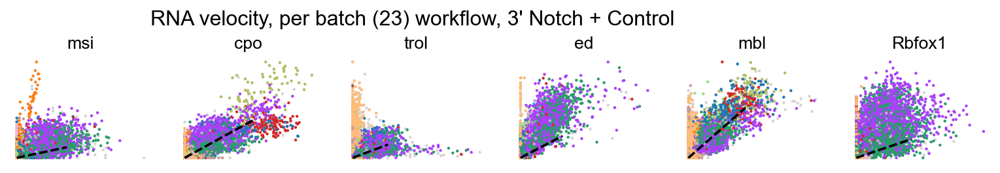

In [19]:
scv.pl.scatter(adata_notch_control_3p_23, ["msi", "cpo", "trol", 'ed', "mbl", "Rbfox1"], color='high_res_annotation', frameon=False, size=15, linewidth=1.5, show=False)
plt.suptitle("RNA velocity, per batch (23) workflow, 3' Notch + Control", y=1.25)
plt.show()

In [ ]:
# Standard rna velocity workflow
scv.pp.filter_genes(adata_notch_control_3p, min_shared_counts=20)        
scv.pp.normalize_per_cell(adata_notch_control_3p)
sc.pp.highly_variable_genes(adata_notch_control_3p, n_top_genes=500)
sc.pp.log1p(adata_notch_control_3p)
scv.pp.pca(adata_notch_control_3p, n_comps=50) # 50 is the default value
sc.pp.neighbors(adata_notch_control_3p, use_rep="X_pca", n_neighbors=15) # knn 15 is the default value 
scv.pp.moments(adata_notch_control_3p, n_pcs=30, n_neighbors=30)
scv.tl.velocity(adata_notch_control_3p, mode="stochastic")
scv.tl.velocity_graph(adata_notch_control_3p)

Filtered out 8918 genes that are detected 20 counts (shared).
Normalized count data: spliced, unspliced.
If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing neighbors
    finished (0:00:03) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:04) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities


/opt/homebrew/Caskroom/miniconda/base/envs/rvelo_milo/lib/python3.10/site-packages/scvelo/tools/optimization.py:184: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  gamma[i] = np.linalg.pinv(A.T.dot(A)).dot(A.T.dot(y[:, i]))


    finished (0:00:07) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/8 cores)
    finished (0:00:46) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [6]:
adata_notch_control_3p.uns["high_res_annotation_colors"] = ['#1f77b4', 
                                                               '#ff7f0e', 
                                                               '#279e68', 
                                                               '#d62728', 
                                                               '#aa40fc', 
                                                               '#8c564b', 
                                                               '#e377c2',
                                                               '#b5bd61', 
                                                               '#17becf', 
                                                               '#ffbb78', 
                                                               '#98df8a',
                                                                '#ff9896', 
                                                                '#c5b0d5', 
                                                                '#c49c94', 
                                                                '#f7b6d2'] 

In [30]:
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

# try to get rid of the warnings
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning, module="scvelo.plotting.utils")

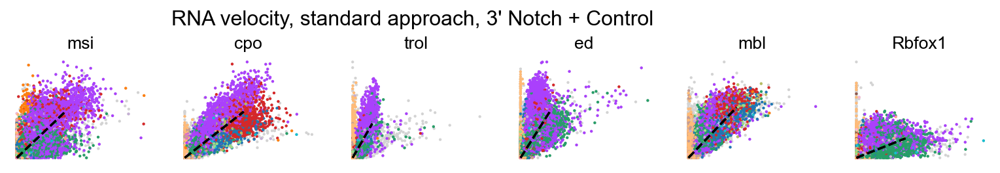

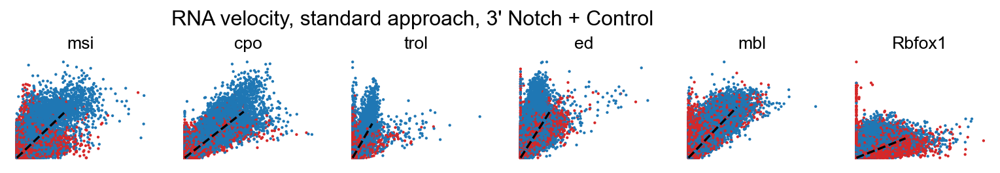

In [32]:
scv.pl.scatter(adata_notch_control_3p, ["msi", "cpo", "trol", 'ed', "mbl", "Rbfox1"], color='high_res_annotation', frameon=False, size=15, linewidth=1.5, show=False)
plt.suptitle("RNA velocity, standard approach, 3' Notch + Control", y=1.25)
plt.show()

adata_notch_control_3p.uns["perturbation_colors"] = ["#1f77b4", "#d62728"]
scv.pl.scatter(adata_notch_control_3p, ["msi", "cpo", "trol", 'ed', "mbl", "Rbfox1"], color='perturbation', frameon=False, size=15, linewidth=1.5, show=False)
plt.suptitle("RNA velocity, standard approach, 3' Notch + Control", y=1.25)
plt.show()

In [17]:
##### RNA velocity "split moments" approach

adata_control_3p = adata[(adata.obs["perturbation"] == "control") & 
                         ((adata.obs["sample_name"] == "TX22_A") | 
                          (adata.obs["sample_name"] == "TX23_A"))].copy()

adata_notch_3p = adata[(adata.obs["perturbation"] == "Notch gRNA") &
                            ((adata.obs["sample_name"] == "TX22_D") |
                            (adata.obs["sample_name"] == "TX23_D"))].copy()

adata_notch_control_3p_moments = velocity_inference_moments(adata_control_3p, adata_notch_3p)

Normalized count data: spliced, unspliced.
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)
computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:03) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
Normalized count data: spliced, unspliced.
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)
computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:04) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
Filtered out 9458 genes that are detected 20 counts (shared).
Extracted 2000 highly variable genes.


/opt/homebrew/Caskroom/miniconda/base/envs/rvelo_milo/lib/python3.10/site-packages/scvelo/preprocessing/utils.py:705: DeprecationWarning: `log1p` is deprecated since scVelo v0.3.0 and will be removed in a future version. Please use `log1p` from `scanpy.pp` instead.
  log1p(adata)


Logarithmized X.
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing velocities


/opt/homebrew/Caskroom/miniconda/base/envs/rvelo_milo/lib/python3.10/site-packages/scvelo/tools/optimization.py:184: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  gamma[i] = np.linalg.pinv(A.T.dot(A)).dot(A.T.dot(y[:, i]))


    finished (0:00:06) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/8 cores)
    finished (0:00:37) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [18]:
adata_notch_control_3p_moments.uns["high_res_annotation_colors"] = ['#1f77b4', 
                                                               '#ff7f0e', 
                                                               '#279e68', 
                                                               '#d62728', 
                                                               '#aa40fc', 
                                                               '#8c564b', 
                                                               '#e377c2',
                                                               '#b5bd61', 
                                                               '#17becf', 
                                                               '#ffbb78', 
                                                               '#98df8a',
                                                                '#ff9896', 
                                                                '#c5b0d5', 
                                                                '#c49c94', 
                                                                '#f7b6d2'] 

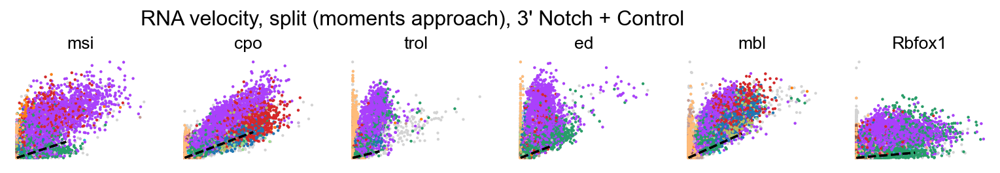

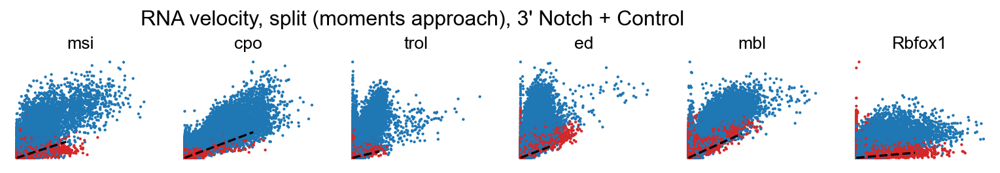

In [22]:
scv.pl.scatter(adata_notch_control_3p_moments, ["msi", "cpo", "trol", 'ed', "mbl", "Rbfox1"], color='high_res_annotation', frameon=False, size=15, linewidth=1.5, show=False)
plt.suptitle("RNA velocity, split (moments approach), 3' Notch + Control", y=1.25)
plt.show()

adata_notch_control_3p_moments.uns["perturbation_colors"] = ["#1f77b4", "#d62728"]
scv.pl.scatter(adata_notch_control_3p_moments, ["msi", "cpo", "trol", 'ed', "mbl", "Rbfox1"], color='perturbation', frameon=False, size=15, linewidth=1.5, show=False)
plt.suptitle("RNA velocity, split (moments approach), 3' Notch + Control", y=1.25)
plt.show()

In [9]:
# correct the RNA velocity data 
def to_hansen(X1, X2):
    """Computes matrices for performing batch effect correction of spliced and unspliced counts.
       idea for batch effect correcting spliced and unspliced counts credited to Hansen lab from thread: https://www.hansenlab.org/velocity_batch

       M = S + U
       R = S / (S + U)

       Sb = Mb*R
       Ub = Mb*(1-R)

    X: list
        list of matrices corresponding to data. Dimensions are 2*n x p
    ----------

    Returns
    M: ndarray
        matrix of summed spliced and unspliced counts. This is log transformed
    R: ndarray 
        matrix to transform data back to original 
    ----------
    """

    if scipy.sparse.issparse(X1) == False:
            X1 = scipy.sparse.csr_matrix(X1)
    if scipy.sparse.issparse(X2) == False:
            X2 = scipy.sparse.csr_matrix(X2)
    
    M = X1 + X2
    R = X1 / (X1 + X2)
    M = np.log1p(M)
    
    return M, R
    
# make the function to correct the data
def velocity_correct_combat(adata, key=None):
    """Correct the RNA velocity data using Combat algorithm from EVi function
    ----------
    adata: AnnData
        AnnData object
        key: str
        key is the batch
        """
    # first step is to sum the spliced and unspliced counts
    M, R = to_hansen(adata.layers["spliced"], adata.layers["unspliced"])
    adata.layers["M"] = M
    adata = adata.copy()
    adata.X = adata.layers["M"]
    # correct using Combat
    sc.pp.combat(adata, key="batch")
    # X1_corr, X2_corr = from_hansen(adata.X, M, R)
    # adata.X = scipy.sparse.csr_matrix(X1_corr) #reset layers, this is corrected data which is in log space
    # adata.layers['spliced'] = scipy.sparse.csr_matrix(np.expm1(X1_corr)) #spliced and unspliced matrices are scaled but not log transformed so invert
    # adata.layers['unspliced'] = scipy.sparse.csr_matrix(np.expm1(X2_corr))
    adata.layers["spliced"], adata.layers["unspliced"] = from_hansen(adata.X, M, R)

    return adata
   

In [ ]:
### RNA velocity batch effect correction with approach from Hansen Lab
sc.pp.pca(adata_notch_control_3p)
sc.pp.neighbors(adata_notch_control_3p, n_neighbors=15)
adata_combat_notch_control_3p = velocity_correct_combat(adata_notch_control_3p, key="batch")
scv.pp.moments(adata_combat_notch_control_3p, n_pcs=30, n_neighbors=30)
scv.tl.velocity(adata_combat_notch_control_3p, mode="stochastic")
scv.tl.velocity_graph(adata_combat_notch_control_3p)

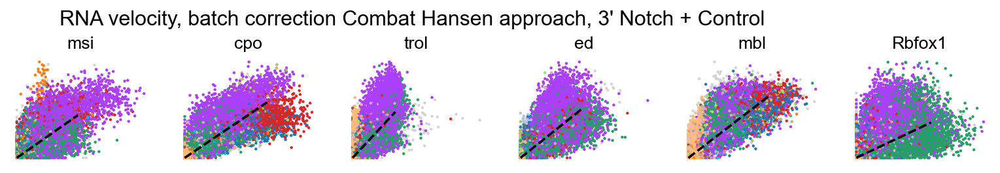

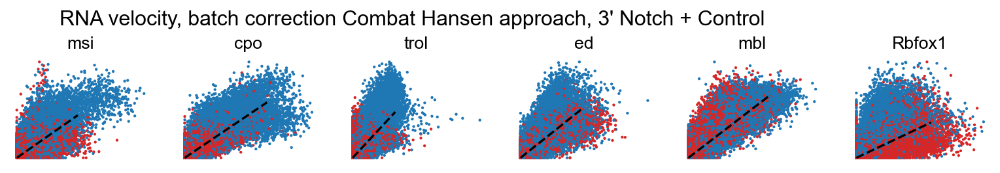

In [ ]:
scv.pl.scatter(adata_combat_notch_control_3p, ["msi", "cpo", "trol", 'ed', "mbl", "Rbfox1"], color='high_res_annotation', frameon=False, size=15, linewidth=1.5, show=False)
plt.suptitle("RNA velocity, batch correction Combat Hansen approach, 3' Notch + Control", y=1.25)
plt.show()

scv.pl.scatter(adata_combat_notch_control_3p, ["msi", "cpo", "trol", 'ed', "mbl", "Rbfox1"], color='perturbation', frameon=False, size=15, linewidth=1.5, show=False)
plt.suptitle("RNA velocity, batch correction Combat Hansen approach, 3' Notch + Control", y=1.25)
plt.show()


# 3.7


 Applying min_shared_counts filter 

Filtered out 10891 genes that are detected 20 counts (shared).
Normalized count data: spliced, unspliced.
If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
'
 Computing PCA, knn and UMAP 
 
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:02)

 Computing RNA velocity 
 
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.

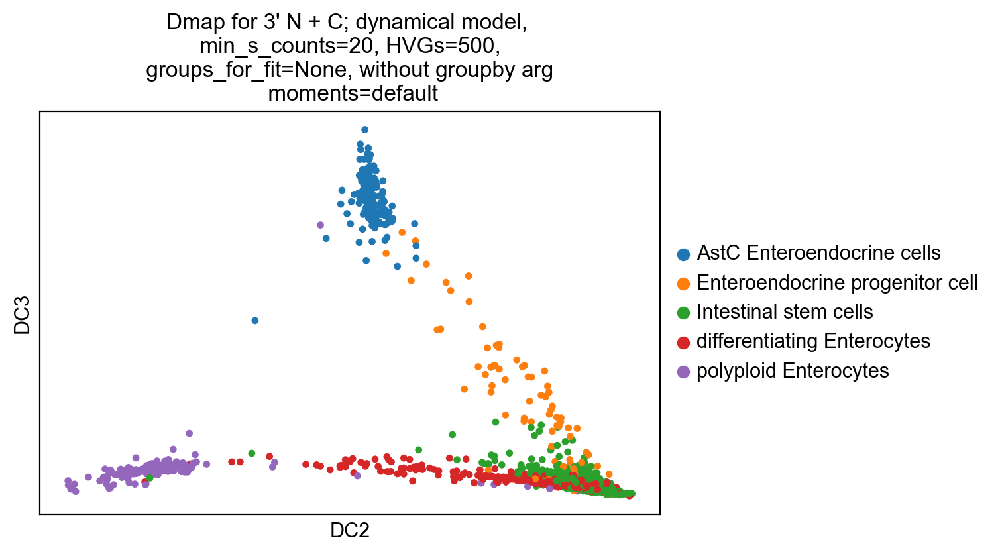

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_diffmap', embedded velocity vectors (adata.obsm)


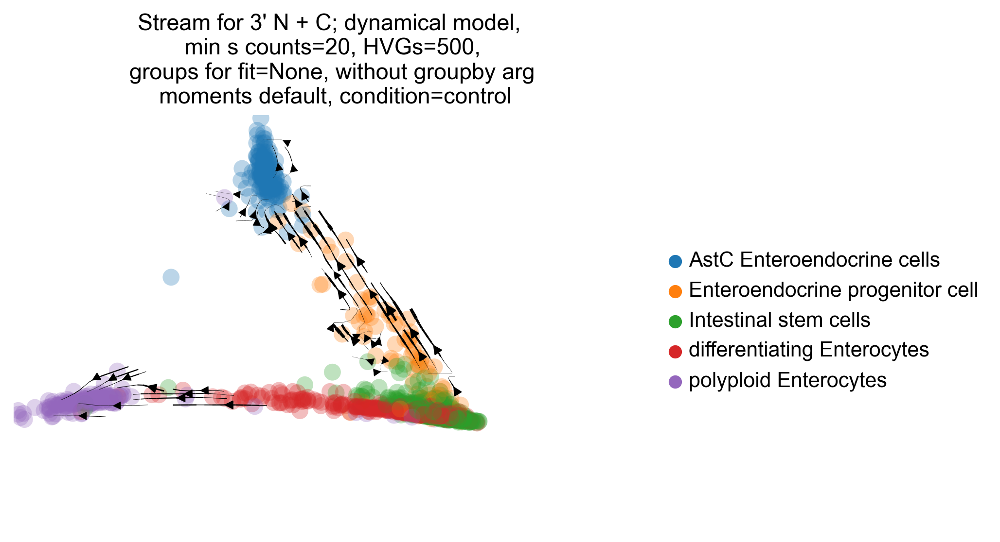

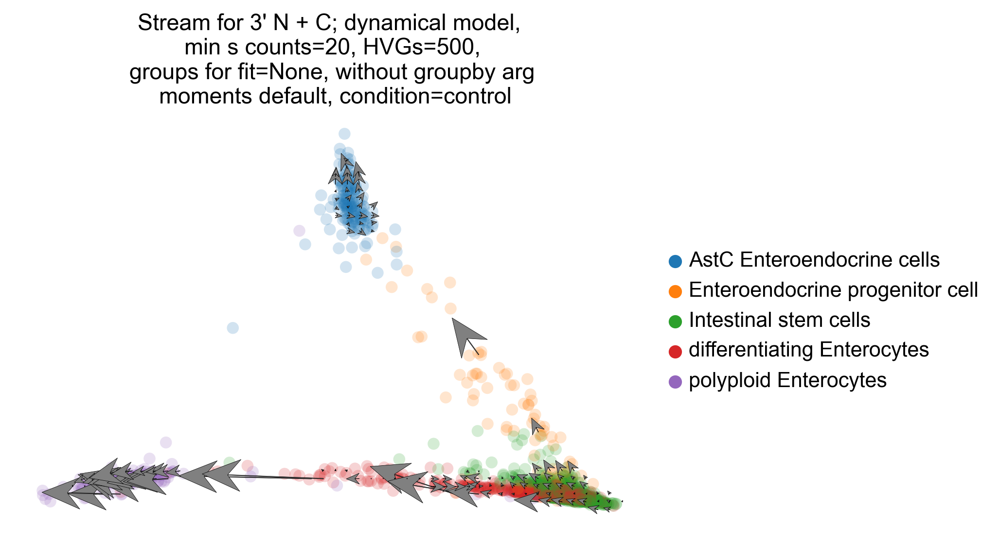

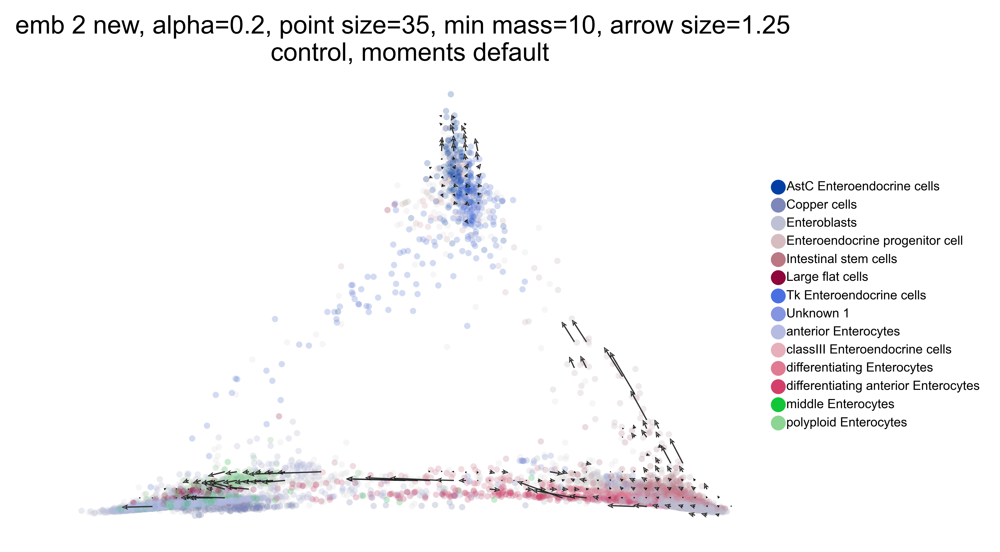

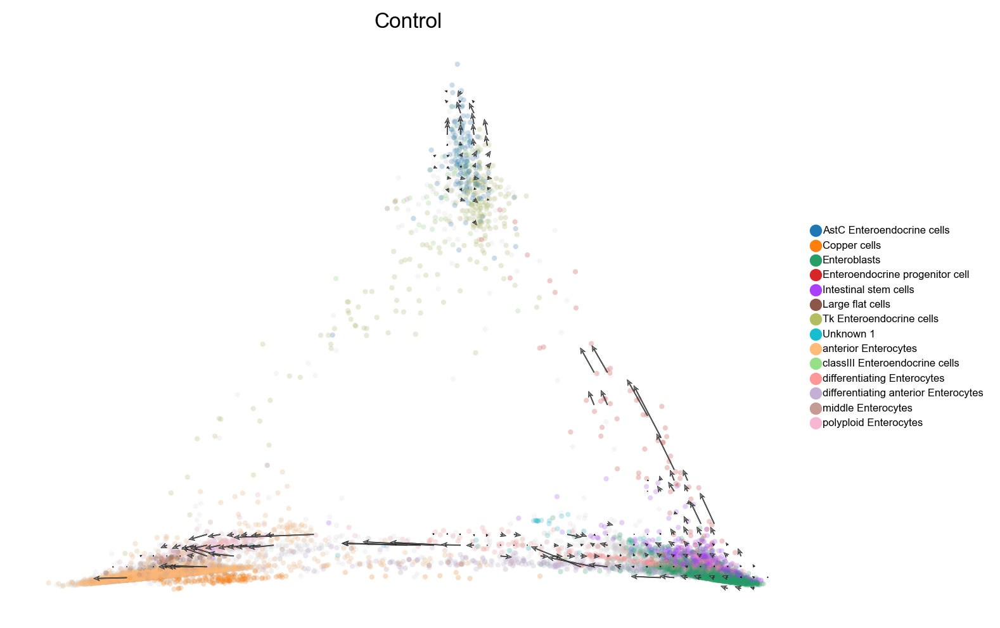

In [33]:
# upload the data
# adata = sc.read_h5ad('/g/huber/users/kharuk/DECODE/a_v_data_merged_DECODE_v1.h5ad')
# uplad the files from the local machine
adata = sc.read_h5ad("/Users/sviatoslavkharuk/Documents/StudyBioinformatics/Bioinformatics_EMBL/Bioinformatics_project_EMBL/scRNA-seq-RNA-velocity-CRISPR-DECODE/Quarto-notebook-DECODE/data/a_v_datas_merged_DECODE_v1_local_machine.h5ad")

# subset the data to the 3' control samples together
adata_control_3p = adata[((adata.obs["perturbation"] == "control") &
                                ((adata.obs["sample_name"] == "TX22_A") |
                                (adata.obs["sample_name"] == "TX23_A")))].copy()

adata_control_3p = adata_control_3p[~adata_control_3p.obs["high_res_annotation"].isin(["Malpighian tubule"])].copy()

""""fit with ISC instead of EB"""
# it looks better!!! 
# fit control samples subsetted data
adata_control_3p = adata[((adata.obs["perturbation"] == "control") &
                                ((adata.obs["sample_name"] == "TX22_A") |
                                (adata.obs["sample_name"] == "TX23_A")))].copy()

adata_control_3p = adata_control_3p[~adata_control_3p.obs["high_res_annotation"].isin(["Malpighian tubule"])].copy()
adata_control_3p_filtered = adata_control_3p[adata_control_3p.obs["high_res_annotation"].isin(["Intestinal stem cells", "AstC Enteroendocrine cells", "Enteroendocrine progenitor cell", "differentiating Enterocytes", "polyploid Enterocytes"])].copy()
# velocity_inferring(adata_control_3p_filtered, mode="dynamical", min_shared_counts=20, n_top_genes=500, annotation="high_res_annotation", groups_for_fit=None, condition="control")
velocity_inferring_local(adata_control_3p_filtered, mode="dynamical", min_shared_counts=20, n_top_genes=500, annotation="high_res_annotation", groups_for_fit=None, condition="control")
# Set plotting style

from matplotlib import rcParams
# Type 2/TrueType fonts
rcParams['pdf.fonttype'] = 42
rcParams['ps.fonttype'] = 42
# Arial font
rcParams['font.sans-serif'] = "Arial"
rcParams['font.family'] = "sans-serif"

# assign the colors to the adata_control_3p

# add diffmap to adata object
# diffmap_csv = pd.read_csv("/g/huber/users/kharuk/DECODE/adata_notch_control_3p_diffmap.csv", index_col=0)
# diffmap from the local machine
diffmap_csv = pd.read_csv("/Users/sviatoslavkharuk/Documents/StudyBioinformatics/Bioinformatics_EMBL/Bioinformatics_project_EMBL/scRNA-seq-RNA-velocity-CRISPR-DECODE/Quarto-notebook-DECODE/data/adata_notch_control_3p_diffmap.csv", index_col=0)
adata_control_3p.obsm["X_diffmap"] = diffmap_csv.loc[adata_control_3p.obs_names].values

# plot the streams of subsetted data on entire
ax = scv.pl.scatter(adata_control_3p, basis="diffmap", color="high_res_annotation", legend_loc="right_margin", legend_fontsize=6, components="1,2", dpi=300, alpha=0.2, size=35, show=False)
scv.pl.velocity_embedding_grid(adata_control_3p_filtered, color="high_res_annotation", basis="diffmap",components="1,2", alpha=0, ax=ax, dpi=300, arrow_size=1.25, min_mass=10, title="emb_2_new, alpha=0.2, point_size=35, min_mass=10, arrow_size=1.25 \n control, moments default")
adata_control_3p.uns["high_res_annotation_colors"]

# add diffmap to adata object
# diffmap_csv = pd.read_csv("/g/huber/users/kharuk/DECODE/adata_notch_control_3p_diffmap.csv", index_col=0)
# diffmap from the local machine
fig, ax = plt.subplots(figsize=(8, 6))

diffmap_csv = pd.read_csv("/Users/sviatoslavkharuk/Documents/StudyBioinformatics/Bioinformatics_EMBL/Bioinformatics_project_EMBL/scRNA-seq-RNA-velocity-CRISPR-DECODE/Quarto-notebook-DECODE/data/adata_notch_control_3p_diffmap.csv", index_col=0)
adata_control_3p.obsm["X_diffmap"] = diffmap_csv.loc[adata_control_3p.obs_names].values

# assign the colors to the adata_control_3p
adata_control_3p.uns["high_res_annotation_colors"] = ['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b',
                                                      '#b5bd61', '#17becf', '#ffbb78', '#98df8a', '#ff9896', '#c5b0d5',
                                                      '#c49c94', '#f7b6d2']
# plot the streams of subsetted data on entire
ax = scv.pl.scatter(adata_control_3p, basis="diffmap", color="high_res_annotation", legend_loc="right_margin", legend_fontsize=6, components="1,2", dpi=300, alpha=0.2, size=35, show=False, ax=ax)
scv.pl.velocity_embedding_grid(adata_control_3p_filtered, color="high_res_annotation", basis="diffmap",components="1,2", alpha=0, ax=ax, dpi=300, arrow_size=1.25, min_mass=10, title="Control")
fig.savefig("/Users/sviatoslavkharuk/Documents/StudyBioinformatics/Bioinformatics_EMBL/Bioinformatics_project_EMBL/scRNA-seq-RNA-velocity-CRISPR-DECODE/Quarto-notebook-DECODE/data/DECODE_streamlines_control.pdf", dpi=300, bbox_inches='tight')
plt.show()

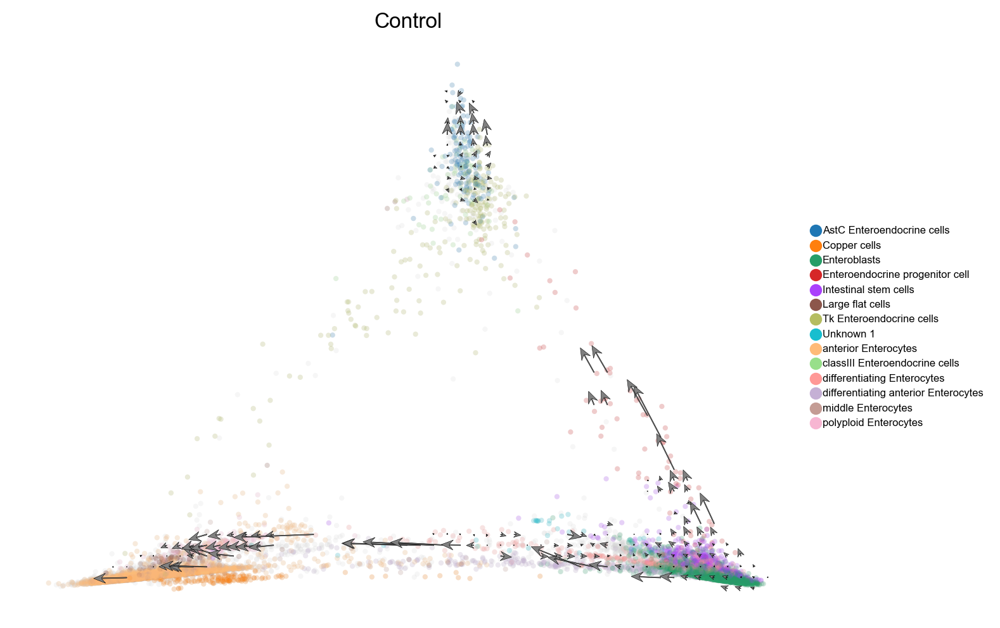

In [34]:
# changing the size of the arrows
fig, ax = plt.subplots(figsize=(8, 6))

ax = scv.pl.scatter(adata_control_3p, basis="diffmap", color="high_res_annotation", legend_loc="right_margin", legend_fontsize=6, components="1,2", dpi=300, alpha=0.2, size=35, show=False, ax=ax)
scv.pl.velocity_embedding_grid(adata_control_3p_filtered, color="high_res_annotation", basis="diffmap",components="1,2", alpha=0, ax=ax, dpi=300, arrow_size=2.5, min_mass=10,title="Control",)
fig.savefig("/Users/sviatoslavkharuk/Documents/StudyBioinformatics/Bioinformatics_EMBL/Bioinformatics_project_EMBL/scRNA-seq-RNA-velocity-CRISPR-DECODE/Quarto-notebook-DECODE/figures/DECODE_streamlines_control_correct.pdf", dpi=300, bbox_inches='tight')
plt.show()


 Applying min_shared_counts filter 

Filtered out 9788 genes that are detected 20 counts (shared).
Normalized count data: spliced, unspliced.
If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
'
 Computing PCA, knn and UMAP 
 
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)

 Computing RNA velocity 
 
computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.o

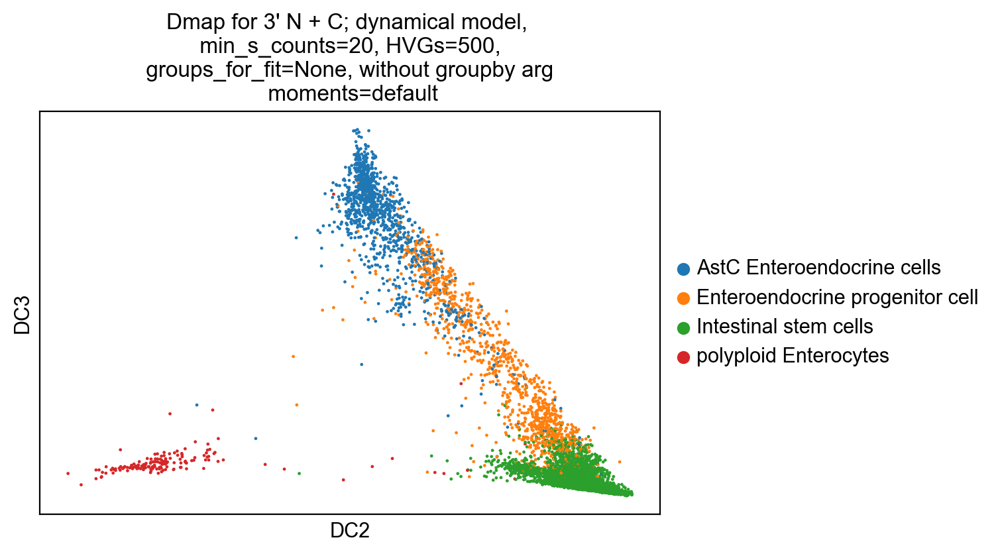

computing velocity embedding
    finished (0:00:01) --> added
    'velocity_diffmap', embedded velocity vectors (adata.obsm)


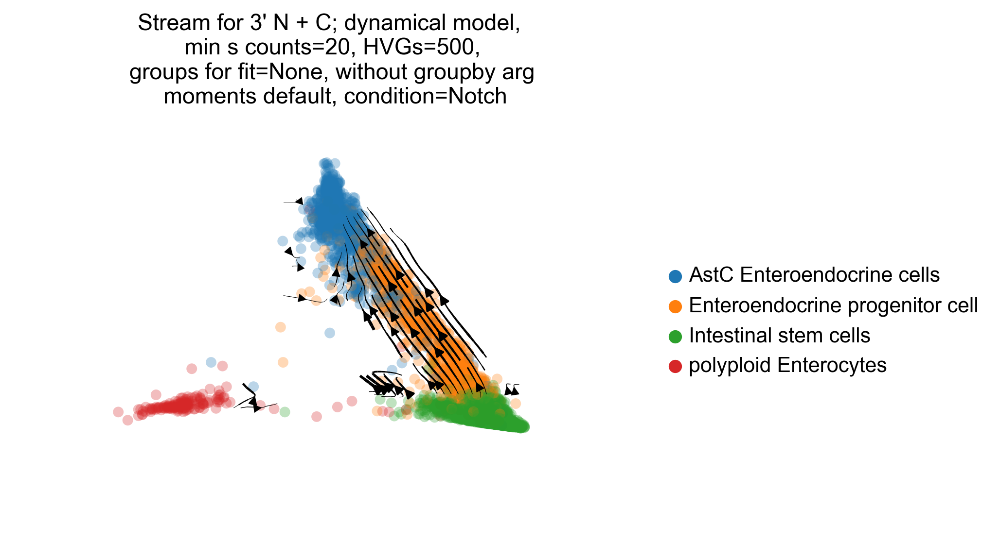

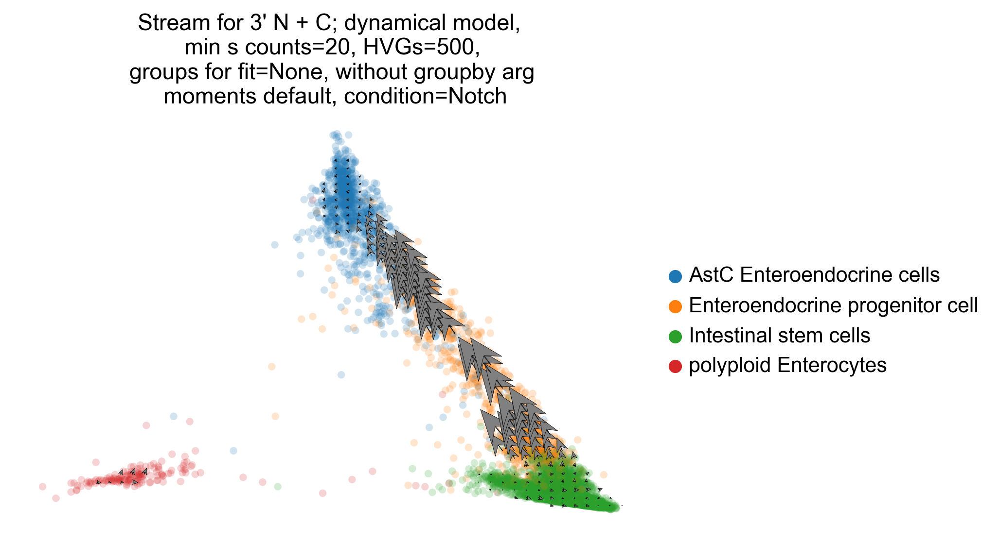

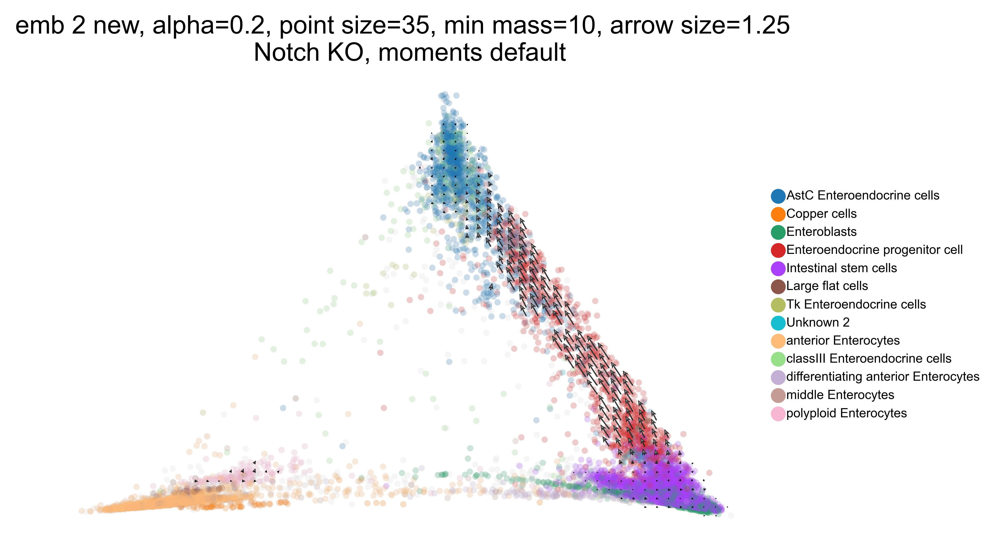

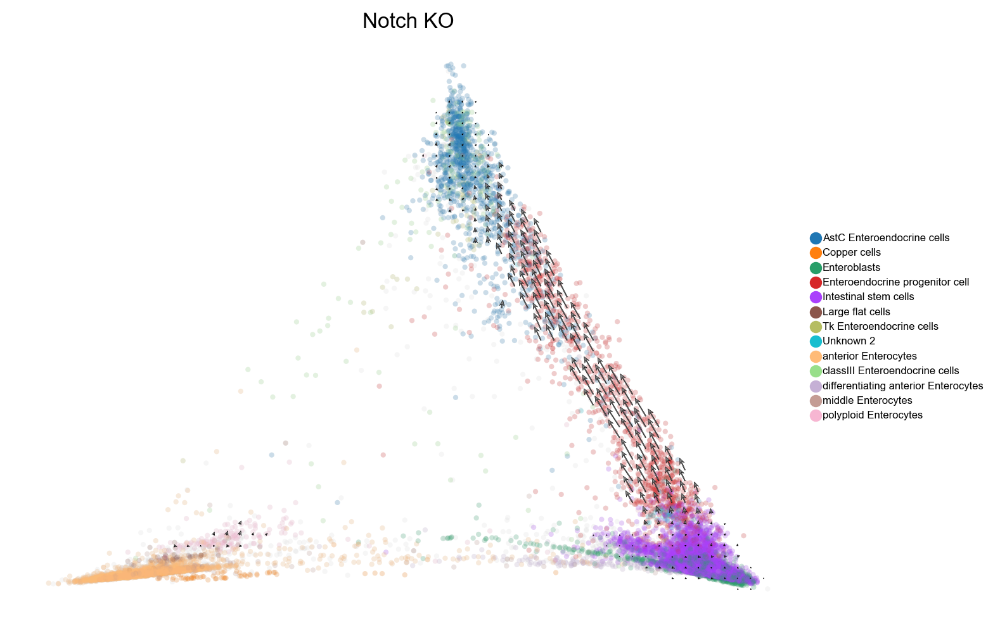

In [35]:
"""Notch KO"""
"""Fit with ISC instead of EB"""
# now subset the cells for the fitting and for Notch condition
adata_notch_3p = adata[((adata.obs["perturbation"] == "Notch gRNA") &
                                ((adata.obs["sample_name"] == "TX22_D") |
                                (adata.obs["sample_name"] == "TX23_D")))].copy()
# add diffmap to adata object
# diffmap_csv = pd.read_csv("/g/huber/users/kharuk/DECODE/adata_notch_control_3p_diffmap.csv", index_col=0)
diffmap_csv = pd.read_csv("/Users/sviatoslavkharuk/Documents/StudyBioinformatics/Bioinformatics_EMBL/Bioinformatics_project_EMBL/scRNA-seq-RNA-velocity-CRISPR-DECODE/Quarto-notebook-DECODE/data/adata_notch_control_3p_diffmap.csv", index_col=0)
adata_notch_3p.obsm["X_diffmap"] = diffmap_csv.loc[adata_notch_3p.obs_names].values

# keep these cell types for inferring
adata_notch_3p_filtered = adata_notch_3p[adata_notch_3p.obs["high_res_annotation"].isin(["Intestinal stem cells", "AstC Enteroendocrine cells", "Enteroendocrine progenitor cell", "differentiating Enterocytes", "polyploid Enterocytes"])].copy()
# velocity_inferring(adata_notch_3p_filtered, mode="dynamical", min_shared_counts=20, n_top_genes=500, annotation="high_res_annotation", groups_for_fit=None, condition="Notch")
velocity_inferring_local(adata_notch_3p_filtered, mode="dynamical", min_shared_counts=20, n_top_genes=500, annotation="high_res_annotation", groups_for_fit=None, condition="Notch")

# plot streams on the entire embedding
adata_notch_3p = adata_notch_3p[~adata_notch_3p.obs["high_res_annotation"].isin(["Malpighian tubule"])].copy()
adata_notch_3p.uns["high_res_annotation_colors"] = ['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b', '#b5bd61', '#17becf', '#ffbb78', '#98df8a', '#c5b0d5', '#c49c94', '#f7b6d2']
ax = scv.pl.scatter(adata_notch_3p, basis="diffmap", color="high_res_annotation", legend_loc="right_margin", legend_fontsize=6, components="1,2", dpi=300, alpha=0.2, size=35, show=False)
scv.pl.velocity_embedding_grid(adata_notch_3p_filtered, color="high_res_annotation", basis="diffmap",components="1,2", alpha=0, ax=ax, dpi=300, arrow_size=1.25, min_mass=10, title="emb_2_new, alpha=0.2, point_size=35, min_mass=10, arrow_size=1.25 \n Notch KO, moments default")

fig, ax = plt.subplots(figsize=(8, 6))


# assign the colors to the adata_notch_3p
adata_notch_3p.uns["high_res_annotation_colors"] = ['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b', '#b5bd61', '#17becf', '#ffbb78', '#98df8a', '#c5b0d5', '#c49c94', '#f7b6d2']
adata_notch_3p = adata_notch_3p[~adata_notch_3p.obs["high_res_annotation"].isin(["Malpighian tubule"])].copy()
ax = scv.pl.scatter(adata_notch_3p, basis="diffmap", color="high_res_annotation", legend_loc="right_margin", legend_fontsize=6, components="1,2", dpi=300, alpha=0.2, size=35, show=False, ax=ax)
scv.pl.velocity_embedding_grid(adata_notch_3p_filtered, color="high_res_annotation", basis="diffmap",components="1,2", alpha=0, ax=ax, dpi=300, arrow_size=1.25, min_mass=10, title="Notch KO")
fig.savefig("/Users/sviatoslavkharuk/Documents/StudyBioinformatics/Bioinformatics_EMBL/Bioinformatics_project_EMBL/scRNA-seq-RNA-velocity-CRISPR-DECODE/Quarto-notebook-DECODE/data/DECODE_streamlines_notch.pdf", dpi=300, bbox_inches='tight')
plt.show()

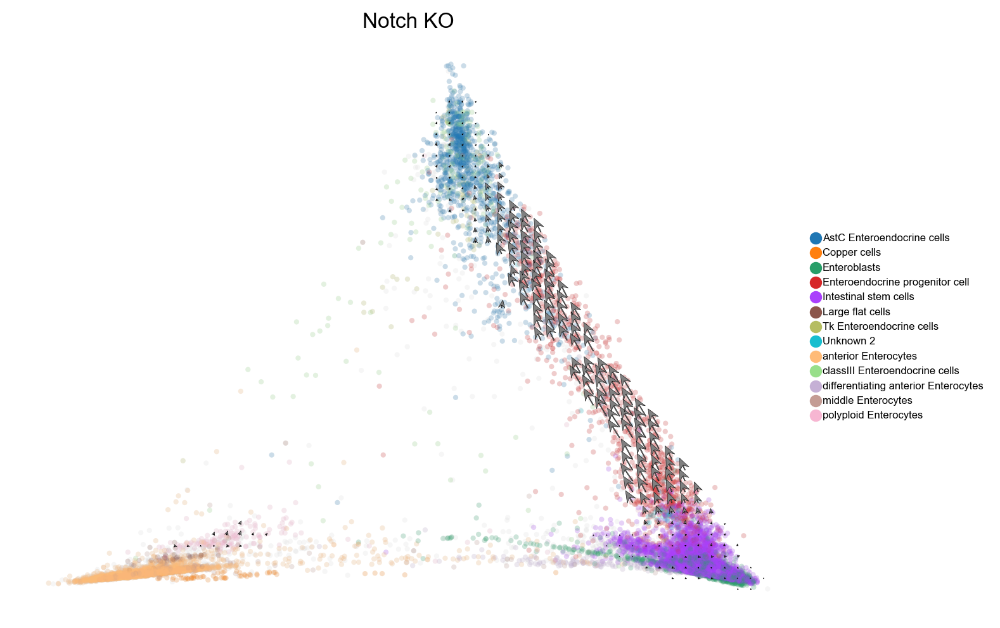

In [36]:
fig, ax = plt.subplots(figsize=(8, 6))

# assign the colors to the adata_notch_3p
ax = scv.pl.scatter(adata_notch_3p, basis="diffmap", color="high_res_annotation", legend_loc="right_margin", legend_fontsize=6, components="1,2", dpi=300, alpha=0.2, size=35, show=False, ax=ax)
scv.pl.velocity_embedding_grid(adata_notch_3p_filtered, color="high_res_annotation", basis="diffmap",components="1,2", alpha=0, ax=ax, dpi=300, arrow_size=2.5, min_mass=10, title="Notch KO")
fig.savefig("/Users/sviatoslavkharuk/Documents/StudyBioinformatics/Bioinformatics_EMBL/Bioinformatics_project_EMBL/scRNA-seq-RNA-velocity-CRISPR-DECODE/Quarto-notebook-DECODE/figures/DECODE_streamlines_notch_correct.pdf", dpi=300, bbox_inches='tight')
plt.show()

RNA velocity does not recapitulate trajectories with all cell types


 Applying min_shared_counts filter 

Filtered out 9834 genes that are detected 20 counts (shared).
Normalized count data: spliced, unspliced.
If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
'
 Computing PCA, knn and UMAP 
 
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)

 Computing RNA velocity 
 
computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.o

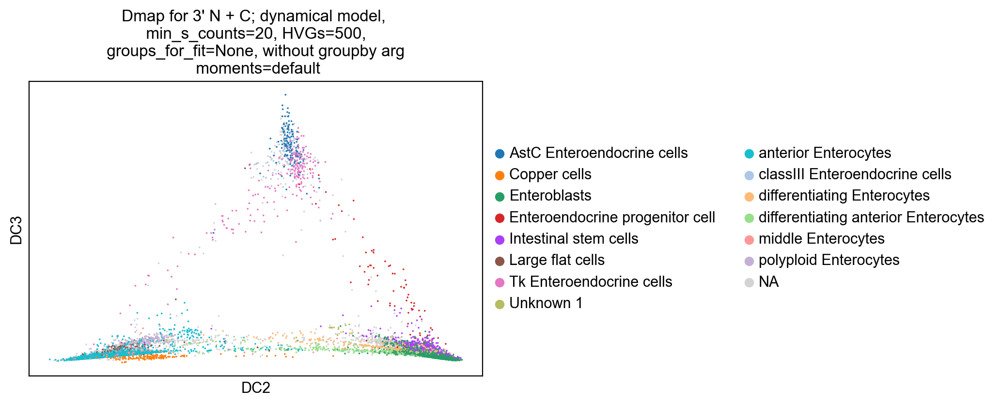

computing velocity embedding
    finished (0:00:01) --> added
    'velocity_diffmap', embedded velocity vectors (adata.obsm)


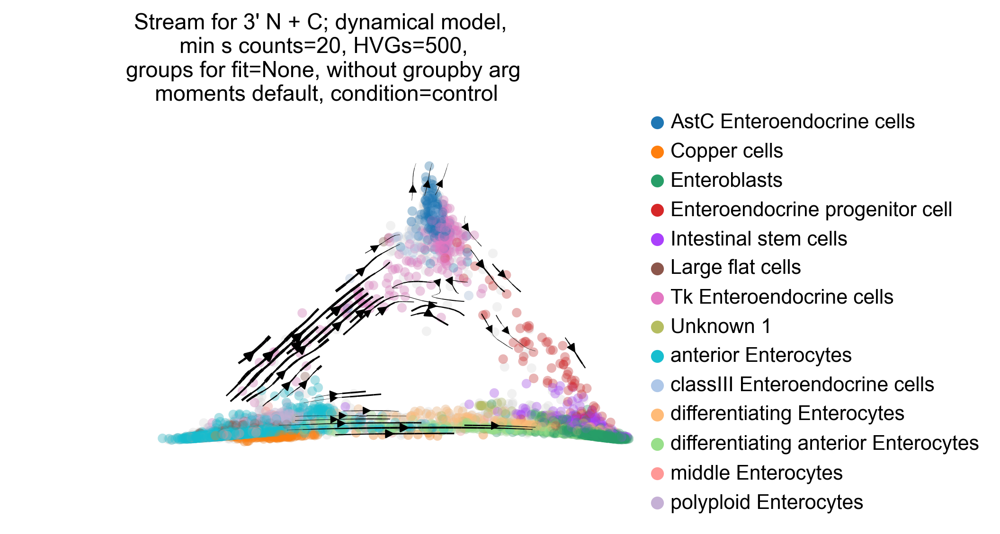

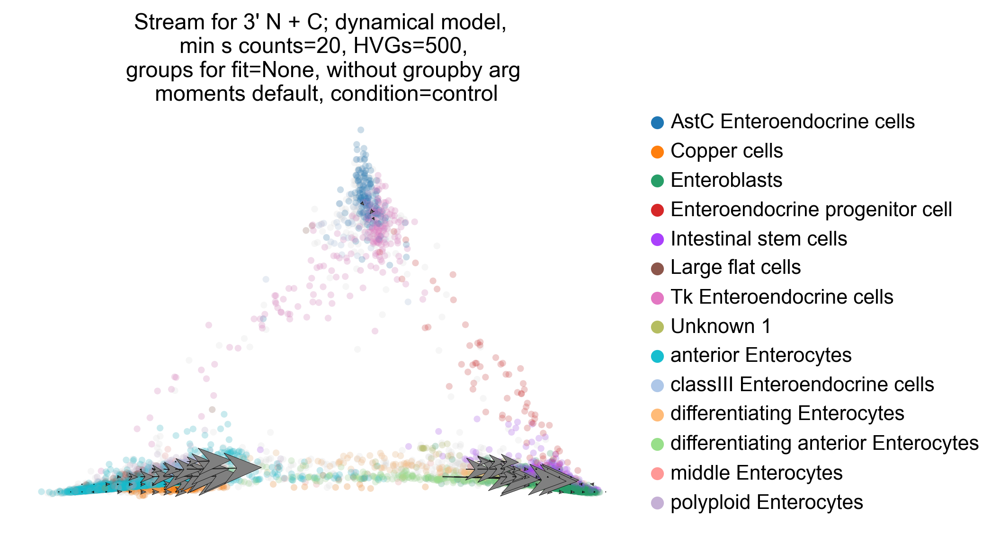

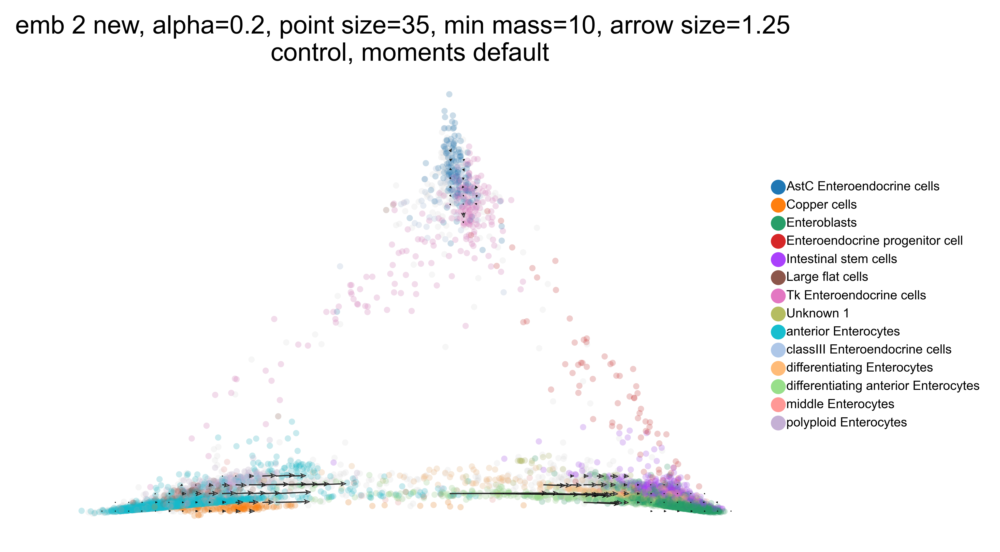

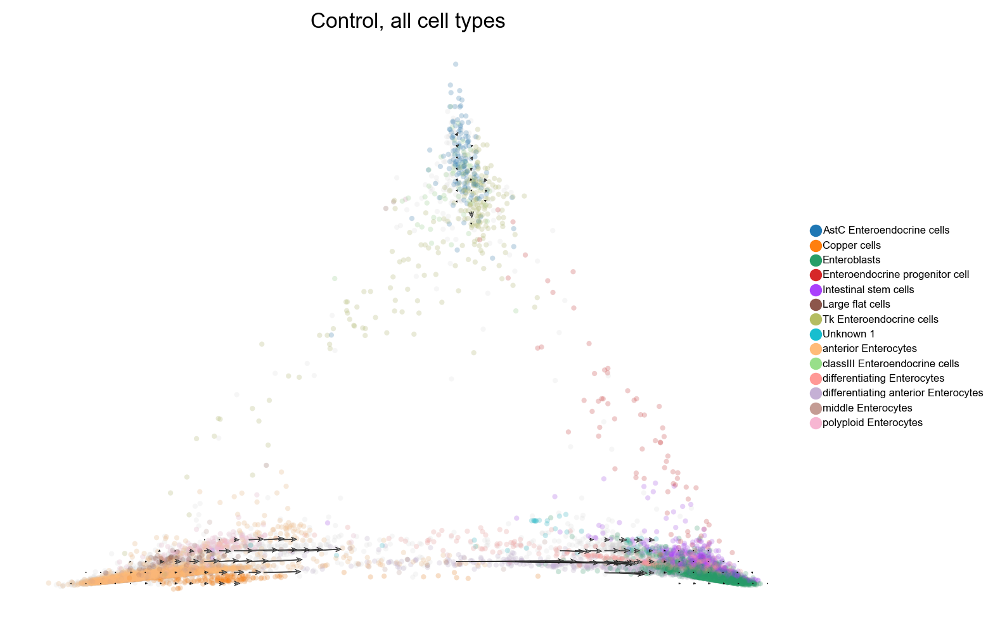

In [37]:
# upload the data
# adata = sc.read_h5ad('/g/huber/users/kharuk/DECODE/a_v_data_merged_DECODE_v1.h5ad')
# uplad the files from the local machine
adata = sc.read_h5ad("/Users/sviatoslavkharuk/Documents/StudyBioinformatics/Bioinformatics_EMBL/Bioinformatics_project_EMBL/scRNA-seq-RNA-velocity-CRISPR-DECODE/Quarto-notebook-DECODE/data/a_v_datas_merged_DECODE_v1_local_machine.h5ad")

# subset the data to the 3' control samples together
adata_control_3p = adata[((adata.obs["perturbation"] == "control") &
                                ((adata.obs["sample_name"] == "TX22_A") |
                                (adata.obs["sample_name"] == "TX23_A")))].copy()

adata_control_3p = adata_control_3p[~adata_control_3p.obs["high_res_annotation"].isin(["Malpighian tubule"])].copy()

""""fit with ISC instead of EB"""
# it looks better!!! 
# fit control samples subsetted data
adata_control_3p = adata[((adata.obs["perturbation"] == "control") &
                                ((adata.obs["sample_name"] == "TX22_A") |
                                (adata.obs["sample_name"] == "TX23_A")))].copy()

adata_control_3p = adata_control_3p[~adata_control_3p.obs["high_res_annotation"].isin(["Malpighian tubule"])].copy()
# velocity_inferring(adata_control_3p_filtered, mode="dynamical", min_shared_counts=20, n_top_genes=500, annotation="high_res_annotation", groups_for_fit=None, condition="control")
velocity_inferring_local(adata_control_3p, mode="dynamical", min_shared_counts=20, n_top_genes=500, annotation="high_res_annotation", groups_for_fit=None, condition="control")
# Set plotting style

from matplotlib import rcParams
# Type 2/TrueType fonts
rcParams['pdf.fonttype'] = 42
rcParams['ps.fonttype'] = 42
# Arial font
rcParams['font.sans-serif'] = "Arial"
rcParams['font.family'] = "sans-serif"

# assign the colors to the adata_control_3p

# add diffmap to adata object
# diffmap_csv = pd.read_csv("/g/huber/users/kharuk/DECODE/adata_notch_control_3p_diffmap.csv", index_col=0)
# diffmap from the local machine
diffmap_csv = pd.read_csv("/Users/sviatoslavkharuk/Documents/StudyBioinformatics/Bioinformatics_EMBL/Bioinformatics_project_EMBL/scRNA-seq-RNA-velocity-CRISPR-DECODE/Quarto-notebook-DECODE/data/adata_notch_control_3p_diffmap.csv", index_col=0)
adata_control_3p.obsm["X_diffmap"] = diffmap_csv.loc[adata_control_3p.obs_names].values

# plot the streams of subsetted data on entire
ax = scv.pl.scatter(adata_control_3p, basis="diffmap", color="high_res_annotation", legend_loc="right_margin", legend_fontsize=6, components="1,2", dpi=300, alpha=0.2, size=35, show=False)
scv.pl.velocity_embedding_grid(adata_control_3p, color="high_res_annotation", basis="diffmap",components="1,2", alpha=0, ax=ax, dpi=300, arrow_size=1.25, min_mass=10, title="emb_2_new, alpha=0.2, point_size=35, min_mass=10, arrow_size=1.25 \n control, moments default")
adata_control_3p.uns["high_res_annotation_colors"]

# add diffmap to adata object
# diffmap_csv = pd.read_csv("/g/huber/users/kharuk/DECODE/adata_notch_control_3p_diffmap.csv", index_col=0)
# diffmap from the local machine
fig, ax = plt.subplots(figsize=(8, 6))

diffmap_csv = pd.read_csv("/Users/sviatoslavkharuk/Documents/StudyBioinformatics/Bioinformatics_EMBL/Bioinformatics_project_EMBL/scRNA-seq-RNA-velocity-CRISPR-DECODE/Quarto-notebook-DECODE/data/adata_notch_control_3p_diffmap.csv", index_col=0)
adata_control_3p.obsm["X_diffmap"] = diffmap_csv.loc[adata_control_3p.obs_names].values

# assign the colors to the adata_control_3p
adata_control_3p.uns["high_res_annotation_colors"] = ['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b',
                                                      '#b5bd61', '#17becf', '#ffbb78', '#98df8a', '#ff9896', '#c5b0d5',
                                                      '#c49c94', '#f7b6d2']
# plot the streams of subsetted data on entire
ax = scv.pl.scatter(adata_control_3p, basis="diffmap", color="high_res_annotation", legend_loc="right_margin", legend_fontsize=6, components="1,2", dpi=300, alpha=0.2, size=35, show=False, ax=ax)
scv.pl.velocity_embedding_grid(adata_control_3p, color="high_res_annotation", basis="diffmap",components="1,2", alpha=0, ax=ax, dpi=300, arrow_size=1.25, min_mass=10, title="Control, all cell types")
fig.savefig("/Users/sviatoslavkharuk/Documents/StudyBioinformatics/Bioinformatics_EMBL/Bioinformatics_project_EMBL/scRNA-seq-RNA-velocity-CRISPR-DECODE/Quarto-notebook-DECODE/data/DECODE_streamlines_control.pdf", dpi=300, bbox_inches='tight')
plt.show()

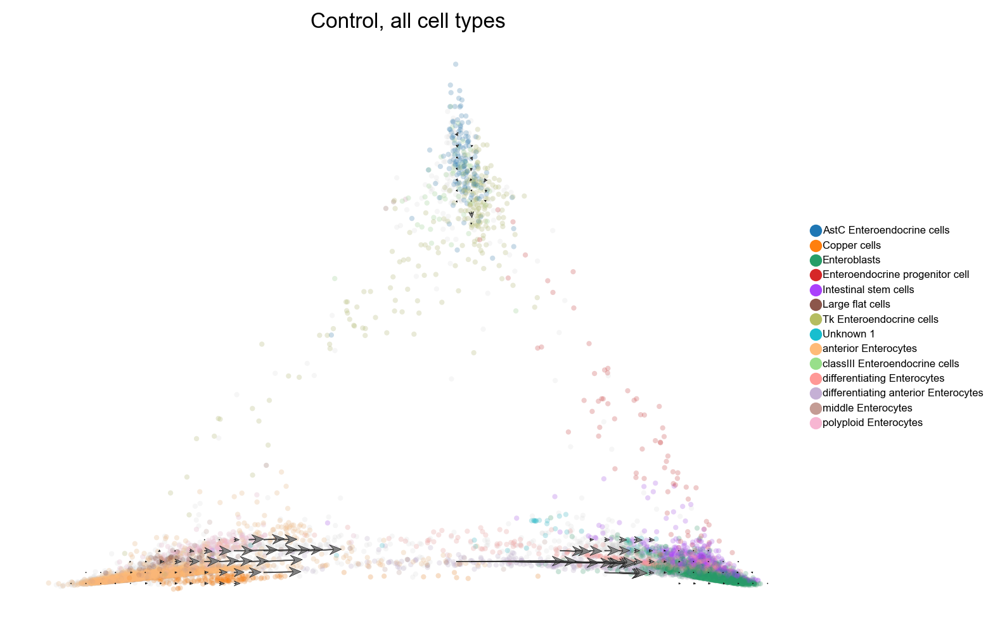

In [38]:
fig, ax = plt.subplots(figsize=(8, 6))

# plot the streams of subsetted data on entire
ax = scv.pl.scatter(adata_control_3p, basis="diffmap", color="high_res_annotation", legend_loc="right_margin", legend_fontsize=6, components="1,2", dpi=300, alpha=0.2, size=35, show=False, ax=ax)
scv.pl.velocity_embedding_grid(adata_control_3p, color="high_res_annotation", basis="diffmap",components="1,2", alpha=0, ax=ax, dpi=300, arrow_size=2.5, min_mass=10, title="Control, all cell types")
fig.savefig("/Users/sviatoslavkharuk/Documents/StudyBioinformatics/Bioinformatics_EMBL/Bioinformatics_project_EMBL/scRNA-seq-RNA-velocity-CRISPR-DECODE/Quarto-notebook-DECODE/figures/DECODE_streamlines_control_wrong.pdf", dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
"""Notch KO"""


 Applying min_shared_counts filter 

Filtered out 9256 genes that are detected 20 counts (shared).
Normalized count data: spliced, unspliced.
If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
'
 Computing PCA, knn and UMAP 
 
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:07)

 Computing RNA velocity 
 
computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.o

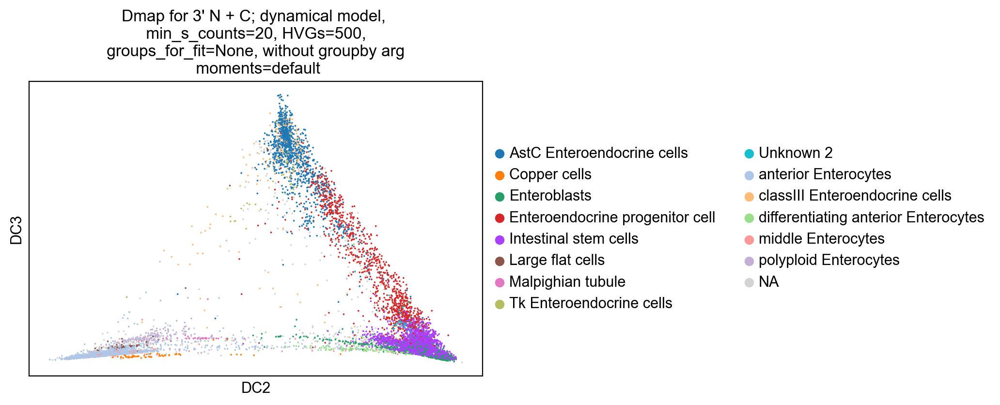

computing velocity embedding
    finished (0:00:01) --> added
    'velocity_diffmap', embedded velocity vectors (adata.obsm)


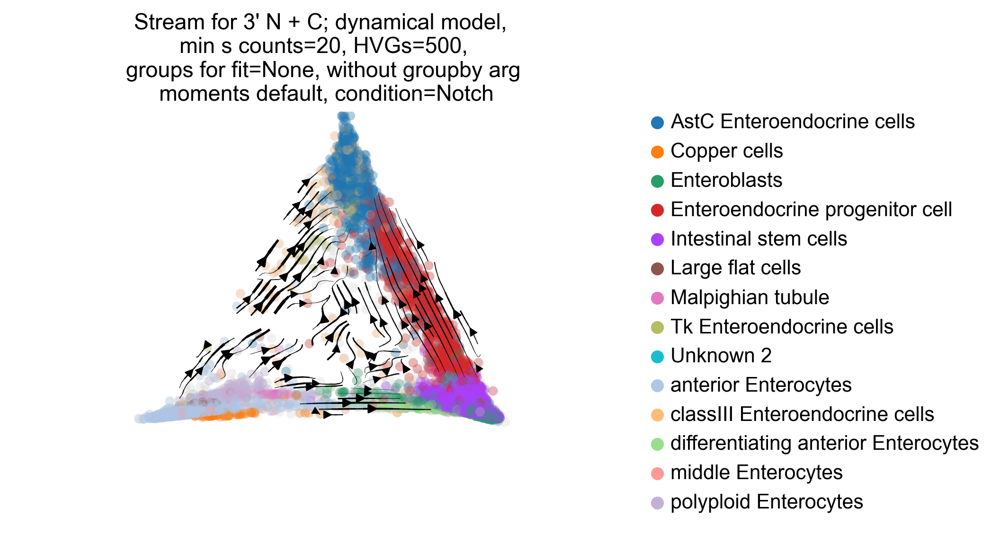

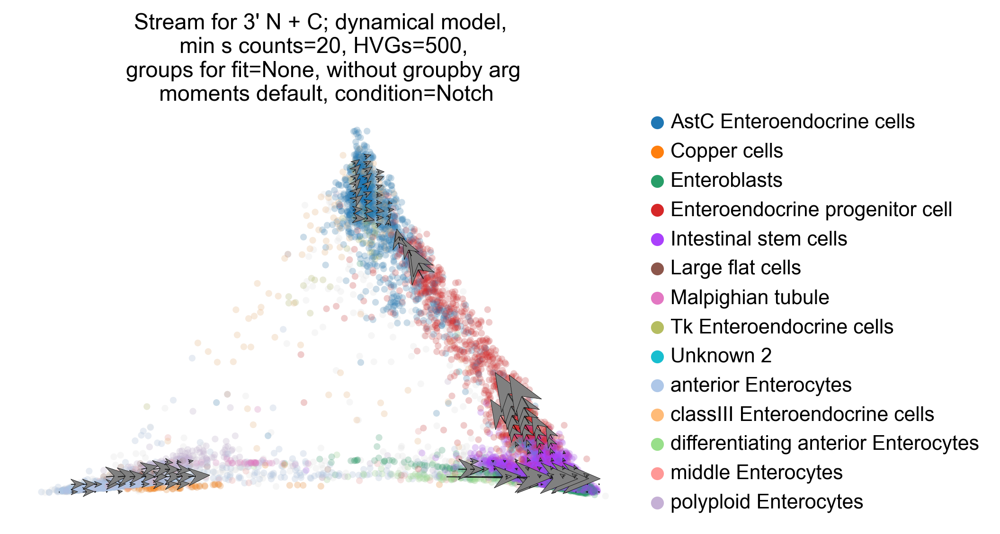

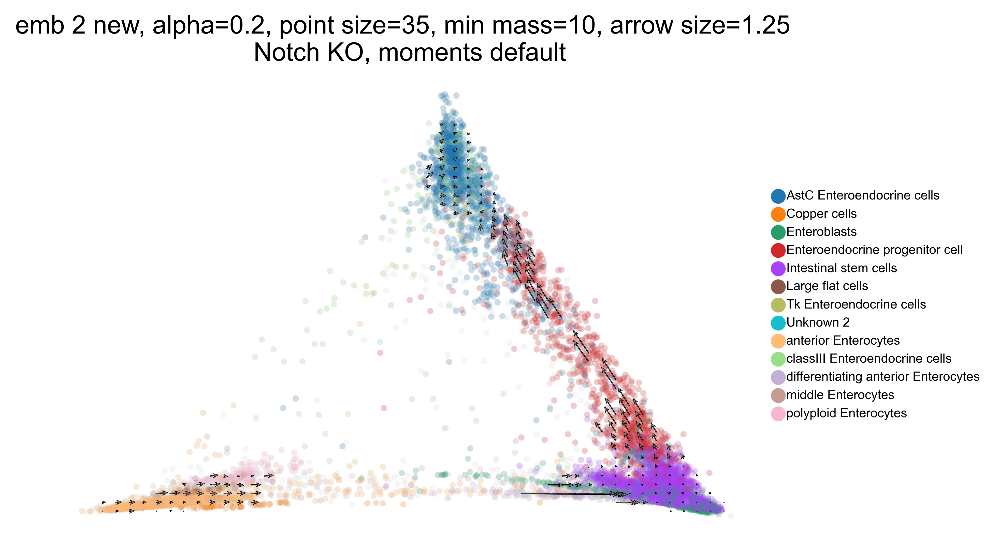

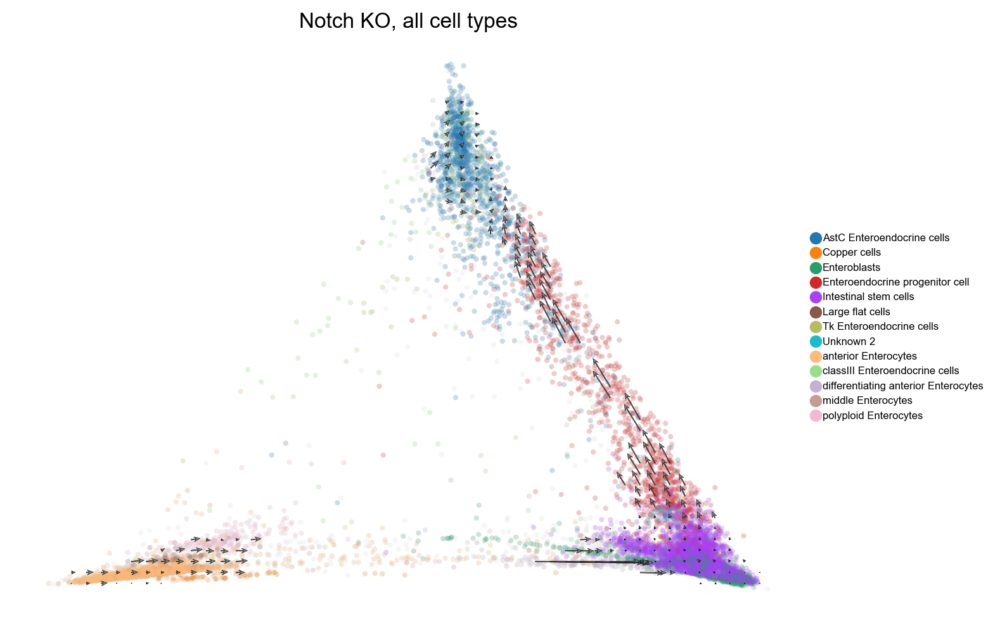

In [39]:
"""Fit with ISC instead of EB"""
# now subset the cells for the fitting and for Notch condition
adata_notch_3p = adata[((adata.obs["perturbation"] == "Notch gRNA") &
                                ((adata.obs["sample_name"] == "TX22_D") |
                                (adata.obs["sample_name"] == "TX23_D")))].copy()
# add diffmap to adata object
# diffmap_csv = pd.read_csv("/g/huber/users/kharuk/DECODE/adata_notch_control_3p_diffmap.csv", index_col=0)
diffmap_csv = pd.read_csv("/Users/sviatoslavkharuk/Documents/StudyBioinformatics/Bioinformatics_EMBL/Bioinformatics_project_EMBL/scRNA-seq-RNA-velocity-CRISPR-DECODE/Quarto-notebook-DECODE/data/adata_notch_control_3p_diffmap.csv", index_col=0)
adata_notch_3p.obsm["X_diffmap"] = diffmap_csv.loc[adata_notch_3p.obs_names].values

# keep these cell types for inferring
# velocity_inferring(adata_notch_3p_filtered, mode="dynamical", min_shared_counts=20, n_top_genes=500, annotation="high_res_annotation", groups_for_fit=None, condition="Notch")
velocity_inferring_local(adata_notch_3p, mode="dynamical", min_shared_counts=20, n_top_genes=500, annotation="high_res_annotation", groups_for_fit=None, condition="Notch")

# plot streams on the entire embedding
adata_notch_3p = adata_notch_3p[~adata_notch_3p.obs["high_res_annotation"].isin(["Malpighian tubule"])].copy()
adata_notch_3p.uns["high_res_annotation_colors"] = ['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b', '#b5bd61', '#17becf', '#ffbb78', '#98df8a', '#c5b0d5', '#c49c94', '#f7b6d2']
ax = scv.pl.scatter(adata_notch_3p, basis="diffmap", color="high_res_annotation", legend_loc="right_margin", legend_fontsize=6, components="1,2", dpi=300, alpha=0.2, size=35, show=False)
scv.pl.velocity_embedding_grid(adata_notch_3p, color="high_res_annotation", basis="diffmap",components="1,2", alpha=0, ax=ax, dpi=300, arrow_size=1.25, min_mass=10, title="emb_2_new, alpha=0.2, point_size=35, min_mass=10, arrow_size=1.25 \n Notch KO, moments default")

fig, ax = plt.subplots(figsize=(8, 6))


# assign the colors to the adata_notch_3p
adata_notch_3p.uns["high_res_annotation_colors"] = ['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b', '#b5bd61', '#17becf', '#ffbb78', '#98df8a', '#c5b0d5', '#c49c94', '#f7b6d2']
adata_notch_3p = adata_notch_3p[~adata_notch_3p.obs["high_res_annotation"].isin(["Malpighian tubule"])].copy()
ax = scv.pl.scatter(adata_notch_3p, basis="diffmap", color="high_res_annotation", legend_loc="right_margin", legend_fontsize=6, components="1,2", dpi=300, alpha=0.2, size=35, show=False, ax=ax)
scv.pl.velocity_embedding_grid(adata_notch_3p, color="high_res_annotation", basis="diffmap",components="1,2", alpha=0, ax=ax, dpi=300, arrow_size=1.25, min_mass=10, title="Notch KO, all cell types")
fig.savefig("/Users/sviatoslavkharuk/Documents/StudyBioinformatics/Bioinformatics_EMBL/Bioinformatics_project_EMBL/scRNA-seq-RNA-velocity-CRISPR-DECODE/Quarto-notebook-DECODE/data/DECODE_streamlines_notch.pdf", dpi=300, bbox_inches='tight')
plt.show()

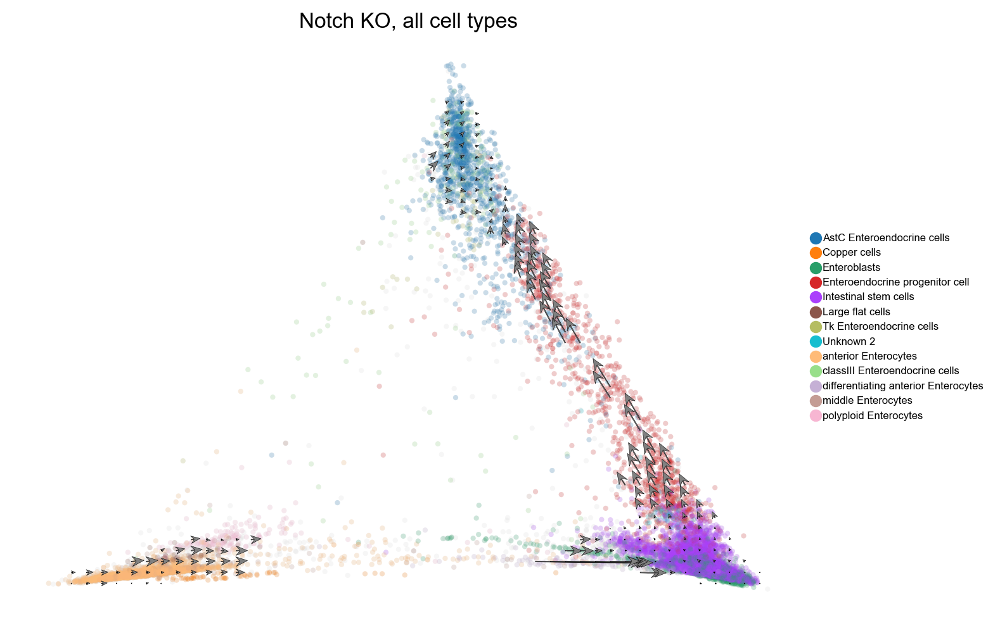

In [40]:
fig, ax = plt.subplots(figsize=(8, 6))

# assign the colors to the adata_notch_3p
ax = scv.pl.scatter(adata_notch_3p, basis="diffmap", color="high_res_annotation", legend_loc="right_margin", legend_fontsize=6, components="1,2", dpi=300, alpha=0.2, size=35, show=False, ax=ax)
scv.pl.velocity_embedding_grid(adata_notch_3p, color="high_res_annotation", basis="diffmap",components="1,2", alpha=0, ax=ax, dpi=300, arrow_size=2.5, min_mass=10, title="Notch KO, all cell types")
fig.savefig("/Users/sviatoslavkharuk/Documents/StudyBioinformatics/Bioinformatics_EMBL/Bioinformatics_project_EMBL/scRNA-seq-RNA-velocity-CRISPR-DECODE/Quarto-notebook-DECODE/figures/DECODE_streamlines_notch_wrong.pdf", dpi=300, bbox_inches='tight')
plt.show()

# 3.8



In [41]:
%load_ext autoreload
%autoreload 2

In [ ]:
pwd

'/Users/sviatoslavkharuk/Documents/StudyBioinformatics/Bioinformatics_EMBL/Bioinformatics_project_EMBL/scRNA-seq-RNA-velocity-CRISPR-DECODE/Quarto-notebook-DECODE/notebooks'

In [42]:
%load_ext autoreload
%autoreload 2
%load_ext rpy2.ipython

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [43]:
%%R
if (!require("BiocManager", quietly = TRUE))
    install.packages("BiocManager")
BiocManager::install("edgeR")

Update all/some/none? [a/s/n]: 

Bioconductor version 3.19 (BiocManager 1.30.25), R 4.4.1 (2024-06-14)
Bioconductor version '3.19' is out-of-date; the current release version '3.20'
  is available with R version '4.4'; see https://bioconductor.org/install
Bioconductor version 3.19 (BiocManager 1.30.25), R 4.4.1 (2024-06-14)
Old packages: 'broom', 'ps', 'rstudioapi', 'FNN', 'MASS', 'Matrix', 'Rcpp',
  'RcppArmadillo', 'abind', 'askpass', 'bit', 'bit64', 'bitops', 'boot',
  'commonmark', 'curl', 'data.table', 'dotCall64', 'evaluate', 'fontawesome',
  'foreign', 'fs', 'future.apply', 'glue', 'gplots', 'gtable', 'igraph',
  'jsonlite', 'knitr', 'later', 'nlme', 'openssl', 'parallelly', 'patchwork',
  'progressr', 'promises', 'reticulate', 'rmarkdown', 'spam', 'spatstat.data',
  'spatstat.explore', 'spatstat.geom', 'spatstat.random', 'spatstat.univar',
  'spatstat.utils', 'survival', 'sys', 'tinytex', 'withr', 'xfun'
In addition: Warning message:
package(s) not installed when version(s) same as or greater than current; use

In [44]:
%%R
BiocManager::install("statmod")


Update all/some/none? [a/s/n]: 

Bioconductor version 3.19 (BiocManager 1.30.25), R 4.4.1 (2024-06-14)
Old packages: 'broom', 'ps', 'rstudioapi', 'FNN', 'MASS', 'Matrix', 'Rcpp',
  'RcppArmadillo', 'abind', 'askpass', 'bit', 'bit64', 'bitops', 'boot',
  'commonmark', 'curl', 'data.table', 'dotCall64', 'evaluate', 'fontawesome',
  'foreign', 'fs', 'future.apply', 'glue', 'gplots', 'gtable', 'igraph',
  'jsonlite', 'knitr', 'later', 'nlme', 'openssl', 'parallelly', 'patchwork',
  'progressr', 'promises', 'reticulate', 'rmarkdown', 'spam', 'spatstat.data',
  'spatstat.explore', 'spatstat.geom', 'spatstat.random', 'spatstat.univar',
  'spatstat.utils', 'survival', 'sys', 'tinytex', 'withr', 'xfun'
In addition: Warning message:
package(s) not installed when version(s) same as or greater than current; use
  `force = TRUE` to re-install: 'statmod' 


In [45]:
%%R
library(edgeR)

Loading required package: limma


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:06)


2024-12-01 15:43:47,082 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-12-01 15:43:59,445 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-12-01 15:43:59,599 - harmonypy - INFO - Iteration 1 of 50
2024-12-01 15:44:09,475 - harmonypy - INFO - Iteration 2 of 50
2024-12-01 15:44:16,780 - harmonypy - INFO - Iteration 3 of 50
2024-12-01 15:44:25,739 - harmonypy - INFO - Iteration 4 of 50
2024-12-01 15:44:33,771 - harmonypy - INFO - Iteration 5 of 50
2024-12-01 15:44:42,649 - harmonypy - INFO - Iteration 6 of 50
2024-12-01 15:44:50,353 - harmonypy - INFO - Iteration 7 of 50
2024-12-01 15:44:59,508 - harmonypy - INFO - Iteration 8 of 50
2024-12-01 15:45:05,664 - harmonypy - INFO - Iteration 9 of 50
2024-12-01 15:45:09,108 - harmonypy - INFO - Converged after 9 iterations


computing neighbors
    finished: added to `.uns['neighbors_harmony_batch']`
    `.obsp['neighbors_harmony_batch_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_harmony_batch_connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:15)
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)


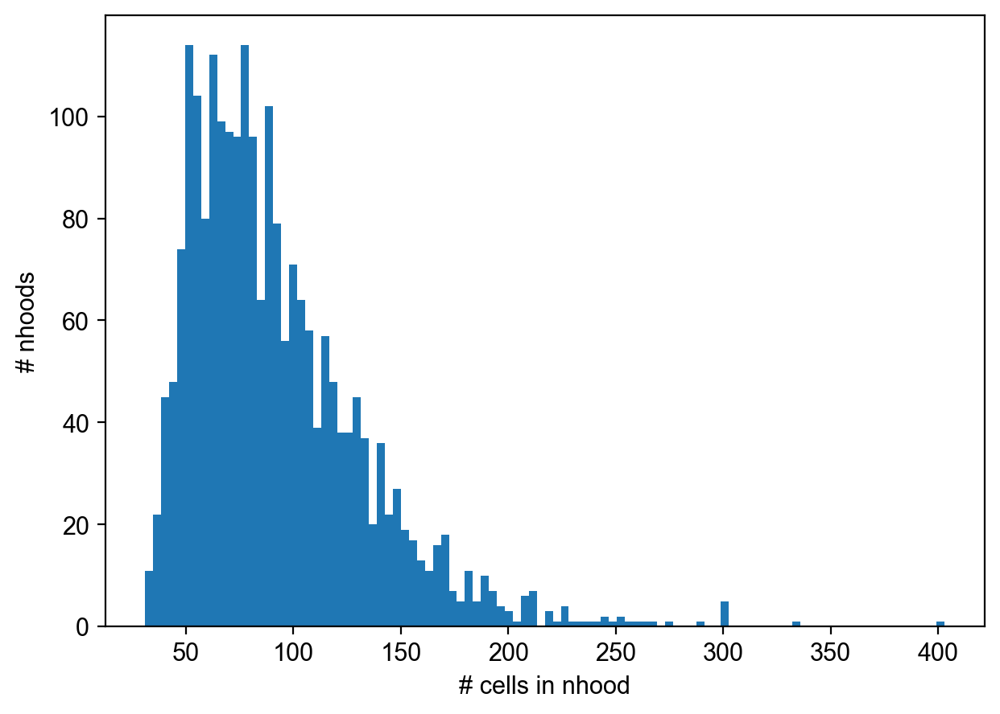

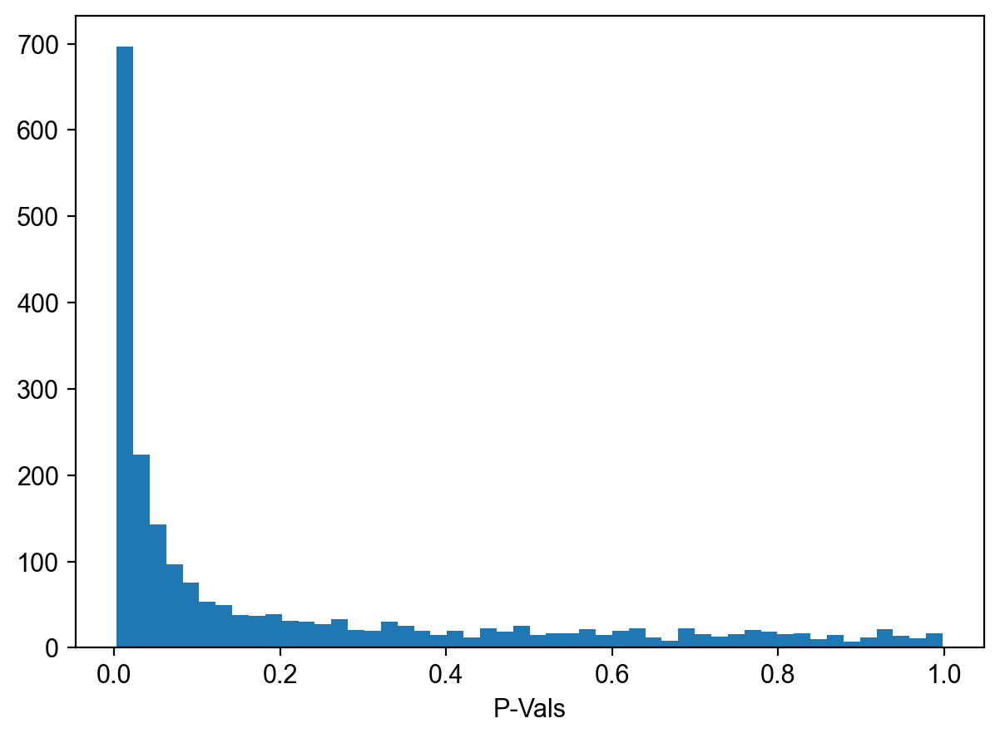

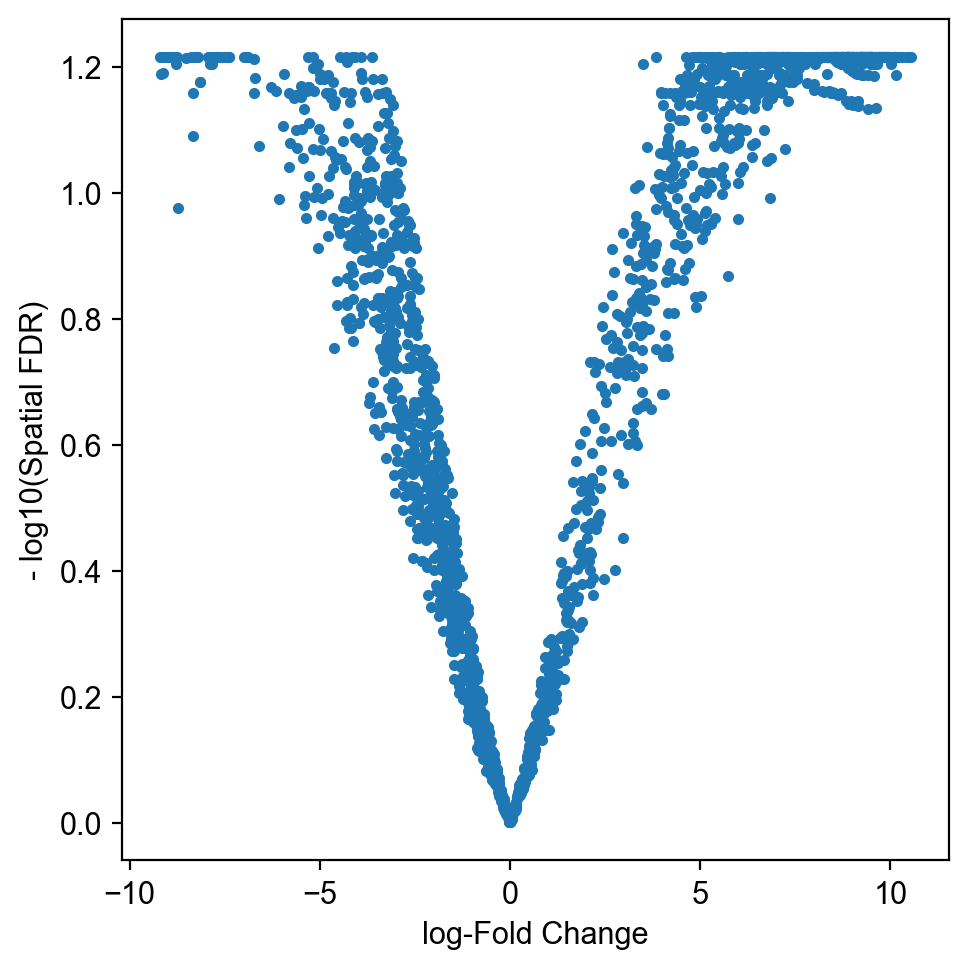

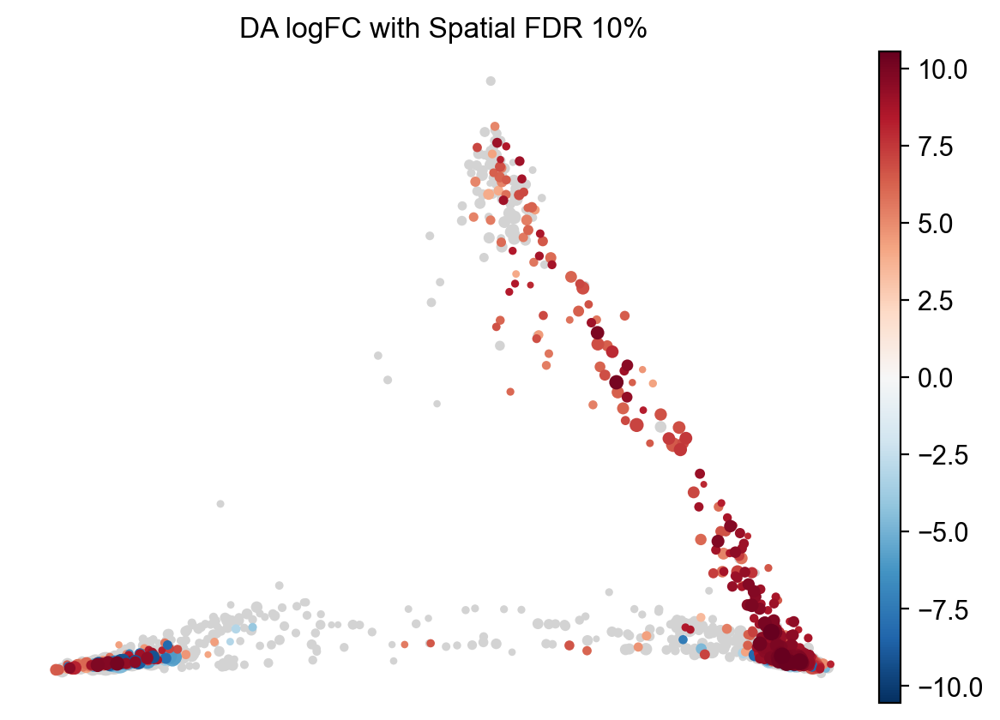

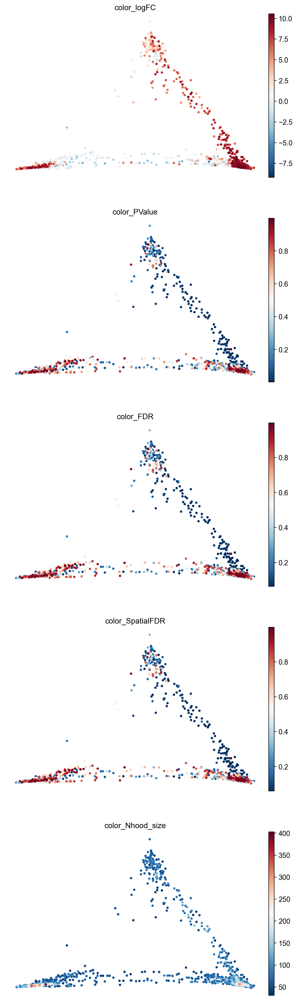

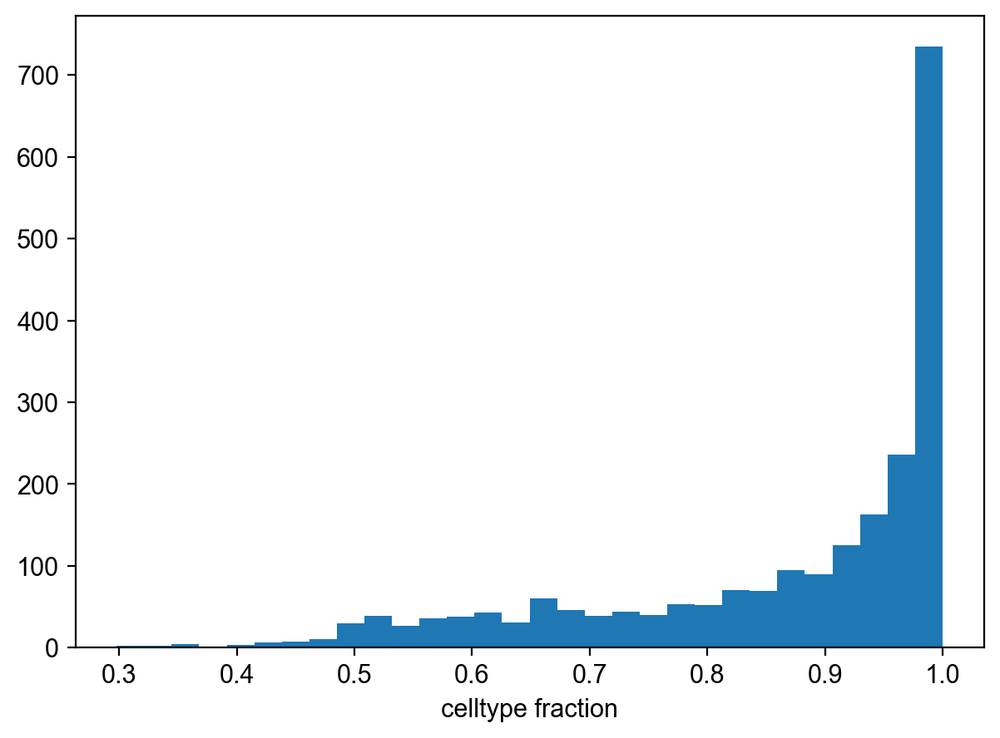

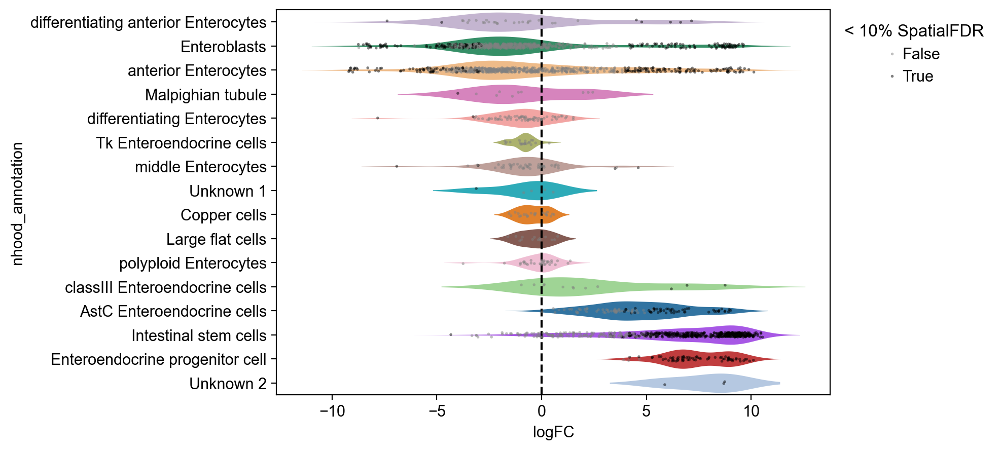

In [51]:
# upload the data
#adata_notch_control_3p_DE = sc.read_h5ad("../data/adata_notch_control_3p_diffmap_local_machine.h5ad")

# upload the data from the cluster on local machine
adata_notch_control_3p_DE = sc.read_h5ad("../data/a_v_data_merged_DECODE_v1_Notch_Control_diffmap.h5ad")
# rvelo-milo env
adata_notch_control_3p_DE, milo, mdata = differential_abundance(adata_notch_control_3p_DE)

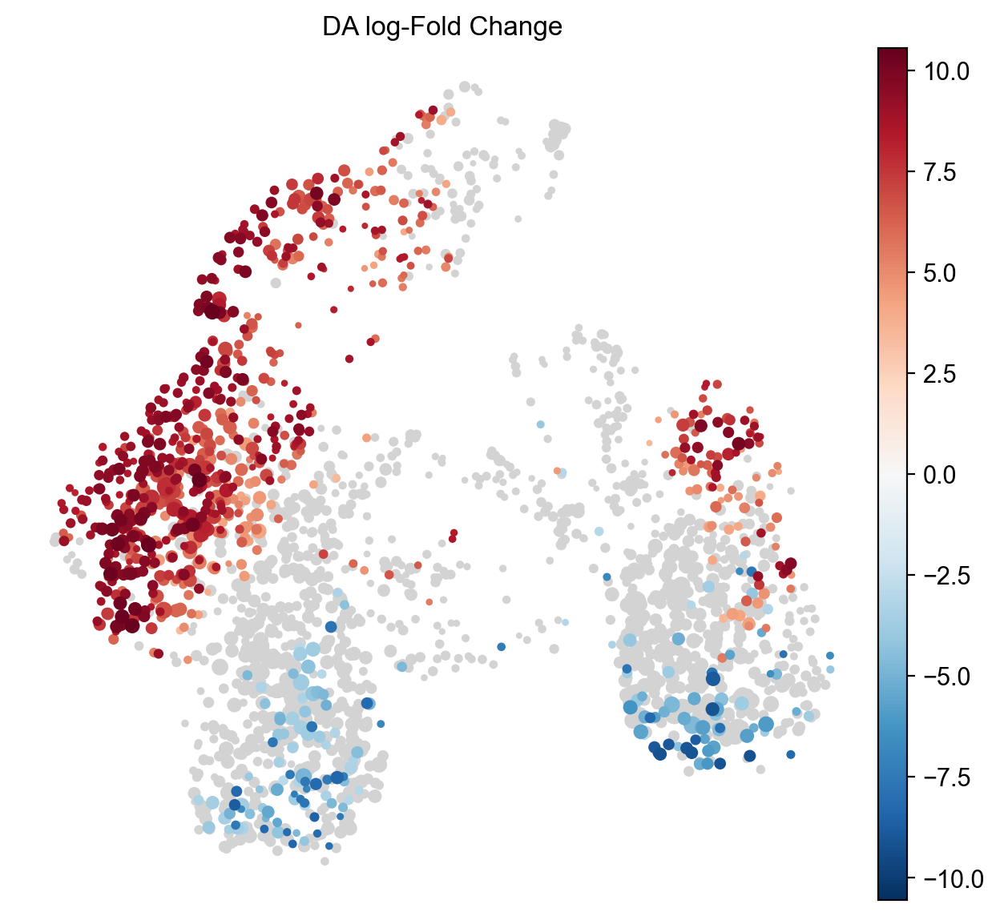

In [52]:
### Visualize results on embedding
milo.build_nhood_graph(mdata)
plt.rcParams["figure.figsize"] = [7.5, 7]
milo.plot_nhood_graph(
    mdata,
    alpha=0.1,  ## SpatialFDR level (10%)
    min_size=1,  ## Size of smallest dot
)